# 12 Posterior Estimation with Different Temp. QC (&& Test for Rank Calculation

Author: Tianze (Vincent) Luo \
Date  : 2025-12-10 Created; 2025-01-06 Updated

In [1]:
######## Load modules ########
from __future__ import annotations #default now for name.error issue
import os
## ensure model trains on one GPU
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
os.environ["WORLD_SIZE"] = "1"
import pickle
from datetime import datetime
import numpy as np
import random
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
SEED = 1234
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)
import scipy
from tqdm import tqdm

# Cell2Sentence imports
import cell2sentence as cs
# from cell2sentence.utils import benchmark_expression_conversion, reconstruct_expression_from_cell_sentence
from cell2sentence import utils
from cell2sentence.tasks import embed_cells, predict_cell_types_of_data
from cell2sentence.prompt_formatter import get_cell_sentence_str, PromptFormatter #for custom prompt

# Hugging Face
from transformers import TrainingArguments, AutoModelForCausalLM
from datasets import Dataset # Arrow

# Single-cell libraries
import scanpy as sc
import anndata as ad
from collections import Counter, defaultdict #count table

sc.set_figure_params(dpi=300, color_map="viridis_r", facecolor="white", )
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

# Define device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.8 anndata==0.9.2 umap==0.5.7 numpy==1.24.4 scipy==1.10.1 pandas==2.0.3 scikit-learn==1.3.2 statsmodels==0.14.1 pynndescent==0.5.13
cpu


## 12.1 [IMPORTANT] Re-load Perturbation Data

Creating expression vectors from posterior cell sentences (`c2s_tvl_11v3_fullLength_perturbation_PosteriorEst.py` > `posterior_sentences_to_expression`), using `reconstruct_expression_from_cell_sentence` in the background, __orders the genes based on `vocab_list`__ (_also same as the `adata.var`; see tut5: post processing and reconstruction; or see below_)

--> this informs how to convert to anndata class for visualization

Also, all non-expressed genes are zeros (built-in from `reconstruct_expression_from_cell_sentence`). Thus, the initial model (using top_k_genes=200, i.e., the input cell sentence is largely trucated) would cause too many __truly expressed genes__ reconstructed as false negatives. __However, this is improved in our top_k_genes=2048 model__, although still not cover most of the expressed genes--this is the capacity of the pretrained model itself.

<span style="color:red">The inference prompt for this example was 3875 genes in total, BUT (after attempting it seems that) this is over the limit of the RAM for CRC, and/or the pretrained model capacity is [2048 genes](https://huggingface.co/vandijklab/C2S-Scale-Pythia-1b-pt).

<span style="color:red">The top_k_genes=2048 model did not exceed the 8192 context length. However, the generation length is limited given the context length cap. __The current generation is likely low quality beyond the available token size, so we can truncate it manually as a remedy__.

In [2]:
DATA_PATH = "/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq/GSE264667_jurkat_processed.h5ad"
adata = ad.read_h5ad(DATA_PATH)
print(adata)             # check dimension
print(adata.X.max())     # check max value (log10 transformation expects a maximum value somewhere around 3 or 4)
print(adata.var_names)   # will be used to create the __cell sentences__
# print(adata.var)

# target_gene_counter = Counter(adata.obs['target_gene'])
# print(f"{len(target_gene_counter)} unique perturbations")
# print(target_gene_counter.most_common(20)) #('non-targeting', 11742)!

AnnData object with n_obs × n_vars = 257412 × 8882
    obs: 'batch_var', 'cell_type', 'target_gene', 'gene_id', 'mitopercent', 'UMI_count', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'batch_var_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
3.3689852
Index(['LINC01409', 'LINC01128', 'NOC2L', 'HES4', 'ISG15', 'TNFRSF4', 'SDF4',
       'B3GALT6', 'UBE2J2', 'ACAP3',
       ...
       'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5', 'MT-ND6',
       'MT-CYB', 'AC240274.1', 'AC004556.3'],
      dtype='object', name='gene_name', length=8882)


In [3]:
# recreate `vocab_list` used in `c2s_tvl_11v3_fullLength_perturbation_PosteriorEst.py` > `posterior_sentences_to_expression`
adata_obs_cols_to_keep = ['batch_var','cell_type','target_gene','gene_id','mitopercent','UMI_count']
arrow_ds, vocabulary = cs.CSData.adata_to_arrow(
    adata=adata, 
    random_state=SEED, 
    sentence_delimiter=' ',
    label_col_names=adata_obs_cols_to_keep
)
print(arrow_ds)
vocab_list = list(vocabulary.keys())

100%|██████████| 257412/257412 [02:17<00:00, 1869.79it/s]


Dataset({
    features: ['cell_name', 'cell_sentence', 'batch_var', 'cell_type', 'target_gene', 'gene_id', 'mitopercent', 'UMI_count'],
    num_rows: 257412
})


In [8]:
print(vocab_list[:10])
print(adata.var_names)

['LINC01409', 'LINC01128', 'NOC2L', 'HES4', 'ISG15', 'TNFRSF4', 'SDF4', 'B3GALT6', 'UBE2J2', 'ACAP3']
Index(['LINC01409', 'LINC01128', 'NOC2L', 'HES4', 'ISG15', 'TNFRSF4', 'SDF4',
       'B3GALT6', 'UBE2J2', 'ACAP3',
       ...
       'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5', 'MT-ND6',
       'MT-CYB', 'AC240274.1', 'AC004556.3'],
      dtype='object', name='gene_name', length=8882)


In [34]:
adata.var

,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
gene_name,,,,,,
LINC01409,36590,False,36590,0.157931,86.085125,41529.0
LINC01128,63541,False,63541,0.293509,75.835881,77180.0
NOC2L,147842,False,147842,0.959111,43.776906,252204.0
HES4,187315,False,187315,2.675265,28.765649,703477.0
ISG15,233241,False,233241,3.166526,11.300370,832657.0
...,...,...,...,...,...,...
MT-ND5,260172,True,260172,13.743919,1.058732,3614046.0
MT-ND6,249591,True,249591,8.905128,5.082599,2341657.0
MT-CYB,262119,True,262119,86.260590,0.318304,22682740.0


(257412, 8882)
3432.069957888521
627
5999


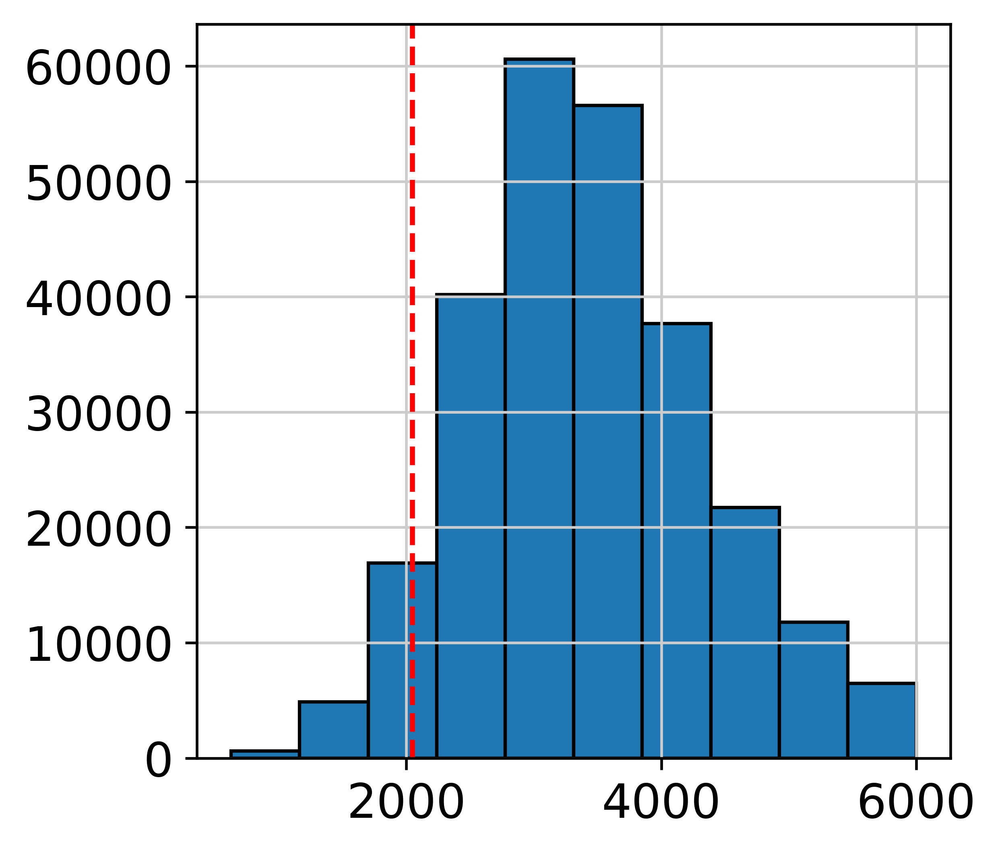

In [115]:
# Compute the average of nonzero expression values per cell (row) from an AnnData object
X = adata.X
row_nnz = (X != 0).sum(axis=1)
# len(row_nnz) #=number of cells
print(X.shape)
print(row_nnz.mean())
print(row_nnz.min())
print(row_nnz.max())

plt.hist(row_nnz, edgecolor='black')
plt.axvline(
    x=2048,         # position of the line
    color="red",    # line color
    linestyle="--", # dashed line
    linewidth=1.5,  # thickness
    label="x=2048"  # optional legend
)
plt.show()

## (deprecated) 12.2 Load Posterior Estimations

Note: saved posterior sentences are unprocessed

In [71]:
# Load the sampling data
benchmarking_wd="/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq/perturbation_predictor_FullLengthFinetuned_final_benchmarking"
with open(os.path.join(benchmarking_wd, "posterior_samples_meta_script11v3Run3.pkl"), "rb") as f:
    meta = pickle.load(f)

# Access results
print(meta["high_temp"].keys())
print(meta["low_temp"].keys())
print()

# same `n_samples`
print(meta["high_temp"]['n_samples'] == meta["low_temp"]['n_samples'])
print("'n_samples':", meta["high_temp"]['n_samples'])
print()
# same `prompt`
print(meta["low_temp"]['prompt'] == meta["high_temp"]['prompt'])
print("prompt:", meta["low_temp"]['prompt'][:1000])
print()

# `temperature`
print("'temperature':")
print(meta["high_temp"]['temperature'])
print(meta["low_temp"]['temperature'])
print()

#### Check cell sentences ####
# meta["high_temp"]['posterior_samples']
# meta["low_temp"]['posterior_samples']

#### Check expression matrix ####
expr_samples_high = meta["high_temp"]["expr_samples"]
expr_samples_low  = meta["low_temp"]["expr_samples"]

print(expr_samples_high.shape)
print(expr_samples_low.shape)

dict_keys(['temperature', 'posterior_samples', 'expr_samples', 'prompt', 'n_samples'])
dict_keys(['temperature', 'posterior_samples', 'expr_samples', 'prompt', 'n_samples'])

True
'n_samples': 100

True
prompt: Given the following cell sentence of 2048 expressed genes representing a cell's basal state, predict the cell sentence after applying the perturbation: NELFE.
Control cell sentence: MT-CO3 MT-ATP6 MT-CO2 MT-ND4 MT-CO1 MT-CYB RPS2 GAPDH RPL13 RPS7 MT-ND1 EEF1A1 RPLP1 RPL7A RPL10 PTMA MT-ND3 RPS3 RPL6 RPS12 RPS3A MALAT1 RPL18A RPS6 ACTB RPS18 RPL37A RACK1 TMSB4X RPL8 RPS23 RPSA RPL18 RPS15 RPS27A RPL32 RPL11 MIF RPL5 RPL15 RPL19 RPL28 TUBA1B MT-ND2 RPL17 RPS14 HSP90AA1 RPL3 H3F3A RPS4X RPL23A RPL30 FTH1 RPL41 RPS13 RPS9 YBX1 RPS16 RPS5 NACA RPS27 RPLP0 FAU RPS19 TPT1 RPL39 RPL7 RPL21 RPL34 TRBC1 RPLP2 RPL26 RPS25 RPL9 RPL29 NME2 EEF1B2 RPS8 PPIA RPS29 RPL27 RPS20 RPS24 EEF1G RPS15A RPL23 RPL36 RPL12 HSP90AB1 RPL14 CALR HINT1 HMGB1 SERF2 RPL37 BTF3 RPL35 RPS28 RPS21 HSPD1 RPL24 RPL

In [72]:
print(expr_samples_high)
print(expr_samples_high.max())

[[0.         0.         0.         ... 2.0871186  0.         0.        ]
 [0.         0.         0.         ... 2.0871186  0.         0.        ]
 [0.         0.         0.40386212 ... 2.0216794  0.         0.        ]
 ...
 [0.         0.         0.         ... 2.0216794  0.         0.        ]
 [0.         0.         0.5621982  ... 2.0871186  0.         0.        ]
 [0.         0.         0.         ... 2.0216794  0.         0.        ]]
2.4936645


In [73]:
# print(meta["high_temp"]['posterior_samples'][4]) #this is un-post-processed!!! Have duplicates

print(len(meta["high_temp"]['posterior_samples'][4].split(" ")) == len(set(meta["high_temp"]['posterior_samples'][4].split(" "))))

print(len(meta["high_temp"]['posterior_samples'][4].split(" ")))
print(len(set(meta["high_temp"]['posterior_samples'][4].split(" "))))

False
2290
1684


## (deprecated) 12.3 Create a merged anndata for visualization to _quality check_ if temperature difference during generation will create a different distribution of the samples (i.e., higher temperature would have a more spread distribution on the shared UMAP)

### `posterior_samples_meta_script11v3Run3.pkl` (top_k_genes=2048)

__Try 1: Use full reconstructed expression matrix__

__Try 2 (later)__: Use union set of the two temperature samples
- Union mask keeps any gene that appears in either temperature at least once, so you preserve temperature-specific support changes while removing genes that are always zero in both groups.

In [74]:
print(expr_samples_low.shape == expr_samples_high.shape)
n_samples, n_genes = expr_samples_low.shape

True


100 8882
8882
AnnData object with n_obs × n_vars = 200 × 8882
    obs: 'temperature'
2.4936645
        temperature
low_0      temp=0.3
low_1      temp=0.3
low_2      temp=0.3
low_3      temp=0.3
low_4      temp=0.3
...             ...
high_95    temp=0.8
high_96    temp=0.8
high_97    temp=0.8
high_98    temp=0.8
high_99    temp=0.8

[200 rows x 1 columns]
computing PCA
    with n_comps=50
    finished (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


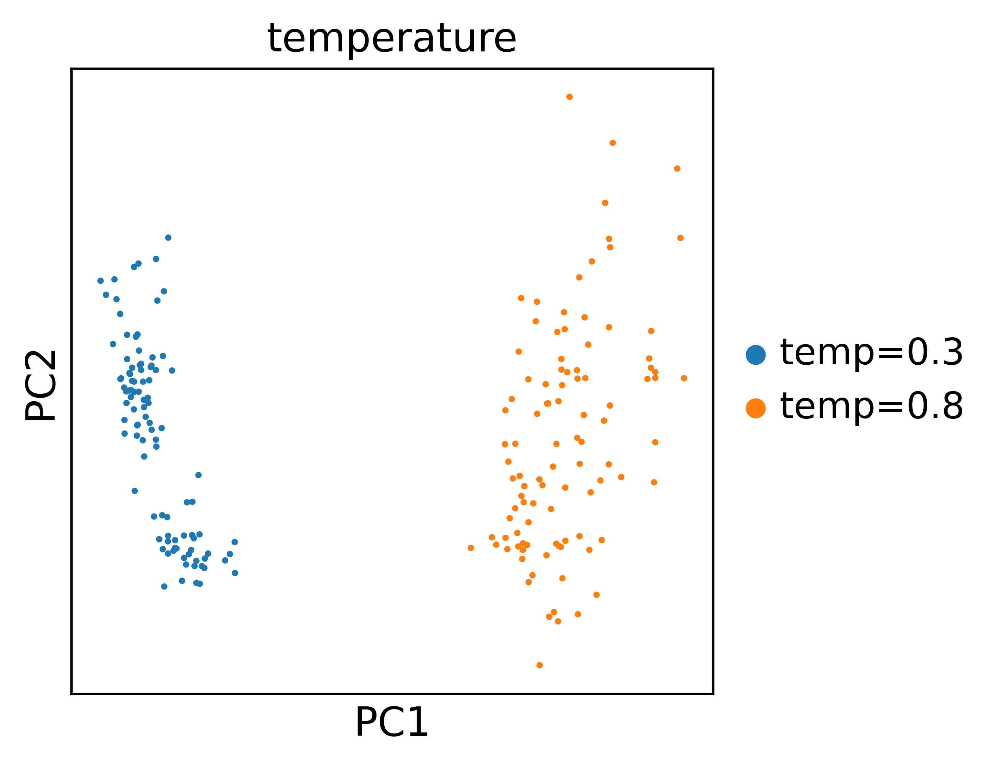

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


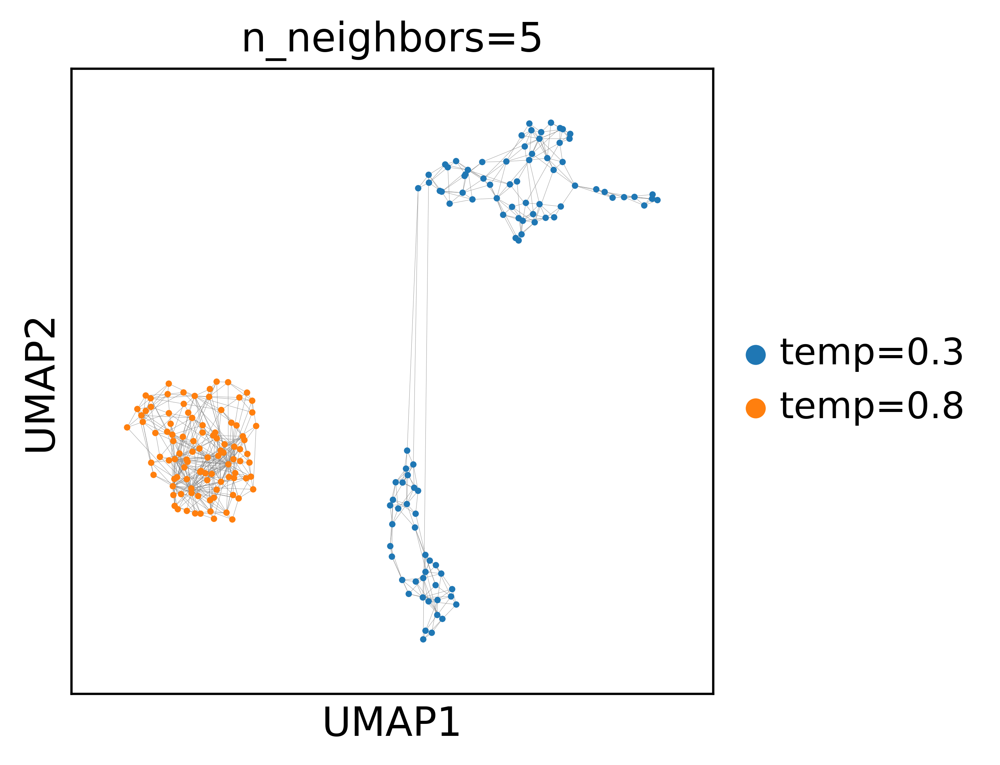

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


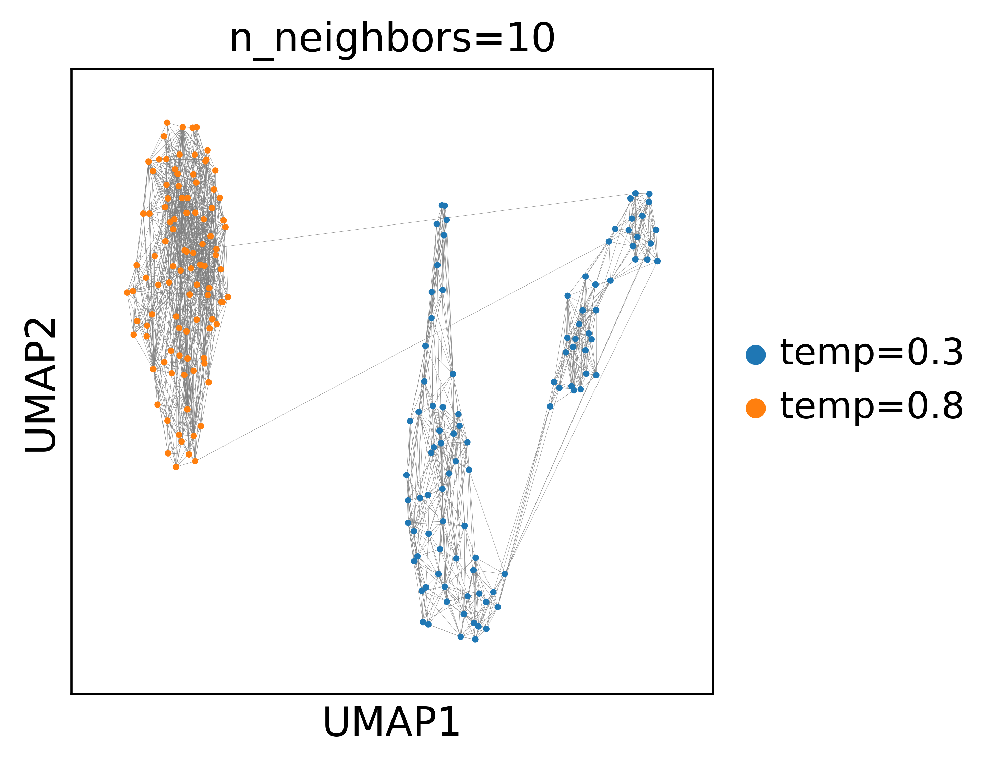

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


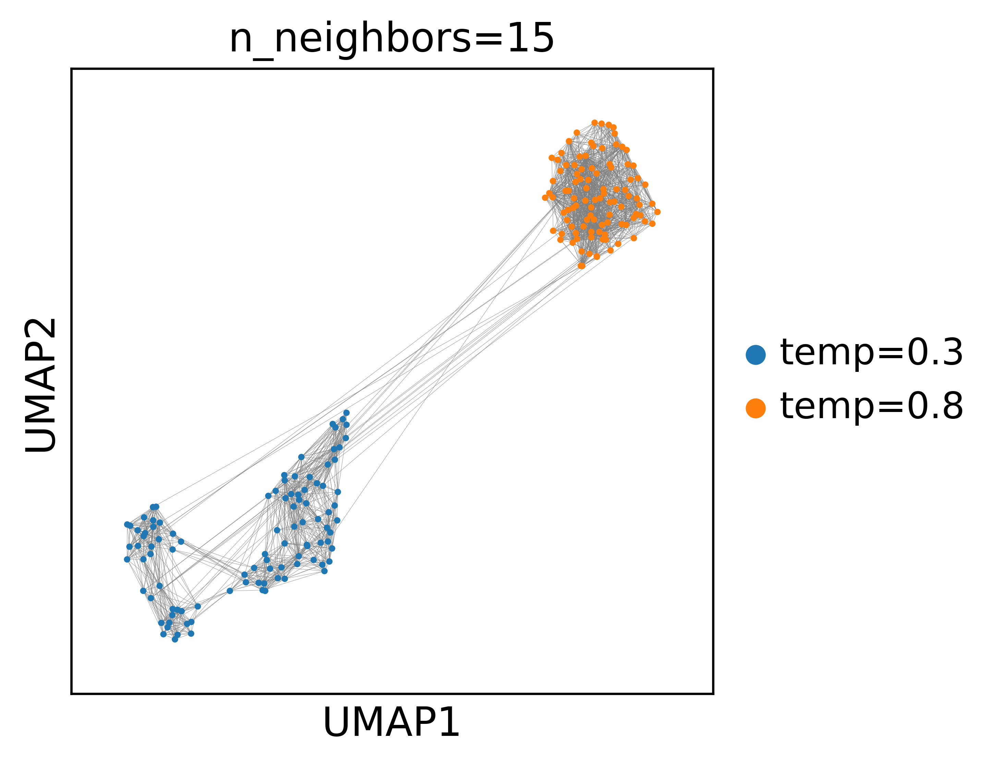

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


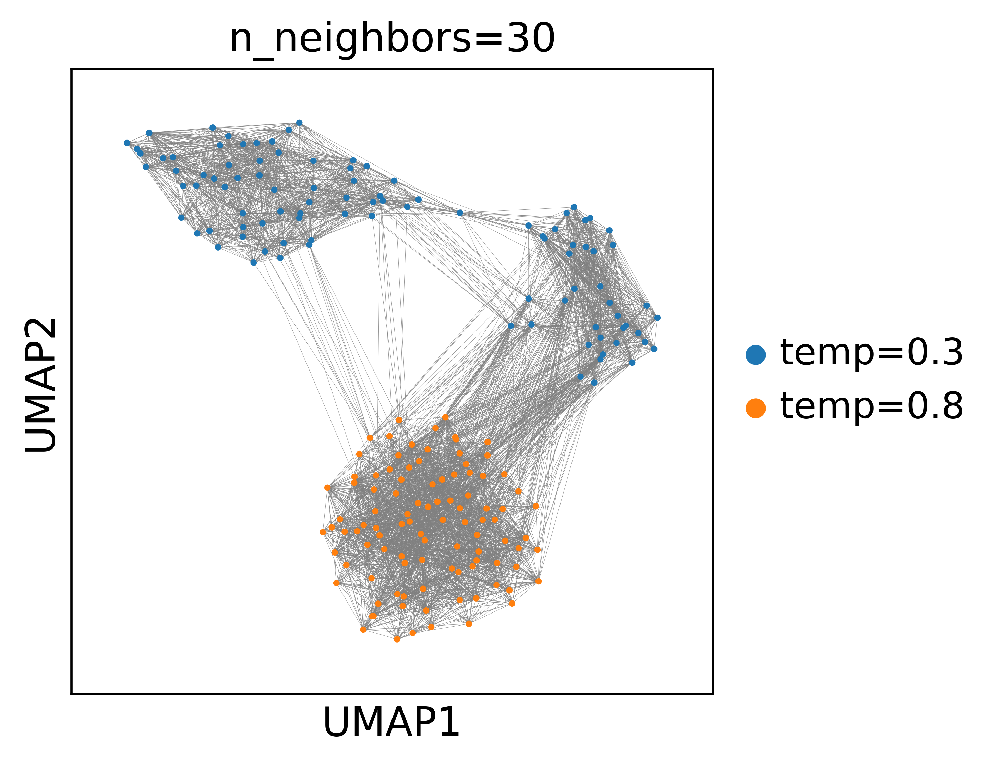

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


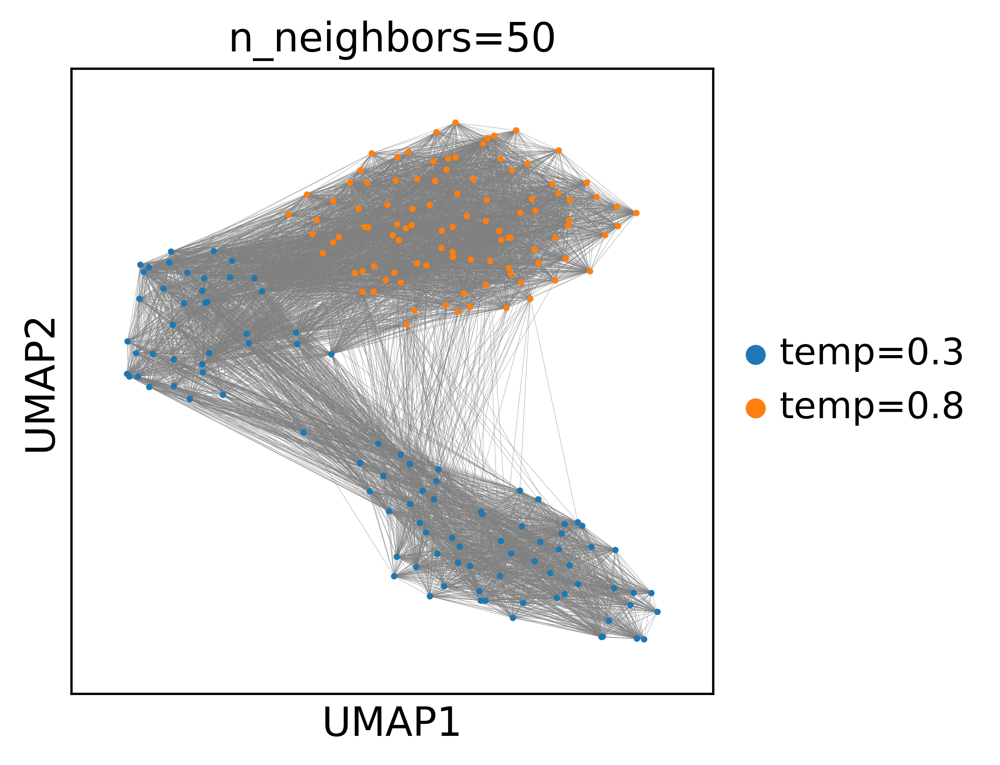

In [75]:
# Check the length of vocab_list and posteroir expression matrix
print(n_samples, n_genes)
print(len(vocab_list))

# 1. obs with temperature labels
obs_low = pd.DataFrame(
    {"temperature": ["temp=0.3"] * n_samples},
    index=[f"low_{i}" for i in range(n_samples)],
)
obs_high = pd.DataFrame(
    {"temperature": ["temp=0.8"] * n_samples},
    index=[f"high_{i}" for i in range(n_samples)],
)
# display(obs_low)
# display(obs_high)

# 2. var copied from your reference adata (or built from vocab_list)
var = pd.DataFrame(index=pd.Index(vocab_list, name="gene"))

adata_low = ad.AnnData(
    X=expr_samples_low.astype(np.float32),
    obs=obs_low,
    var=var,
)
adata_high = ad.AnnData(
    X=expr_samples_high.astype(np.float32),
    obs=obs_high,
    var=var,
)
# print(adata_low)
# print(adata_high)

# 3. concatenate and run PCA/UMAP jointly
concat_adata = ad.concat([adata_low, adata_high], axis=0)
concat_adata.var = var  # ensure var is consistent
print(concat_adata)
print(concat_adata.X.max())
print(concat_adata.obs)

# 4. Visualize (same as in script1)
sc.pp.scale(concat_adata, zero_center=True, max_value=5) #ensure two datasets are transformed correctly before PCA
sc.tl.pca(concat_adata)
sc.pl.pca(
    concat_adata,
    color="temperature",
    size=20,
)

for k in [5, 10, 15, 30, 50]:
    sc.pp.neighbors(concat_adata, n_neighbors=k, n_pcs=50)
    sc.tl.umap(concat_adata)
    sc.pl.umap(concat_adata, color="temperature", size = 20, title=f"n_neighbors={k}", edges = True,)

# sc.pp.neighbors(concat_adata, n_neighbors=15, n_pcs=50)
# sc.tl.umap(concat_adata)

n_neighbors=15 may be the best, given that they are sampling from the same sample and prompt --> should show some connection

<mark>This is problematic since __temp=0.3 is more spread out__</mark>

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


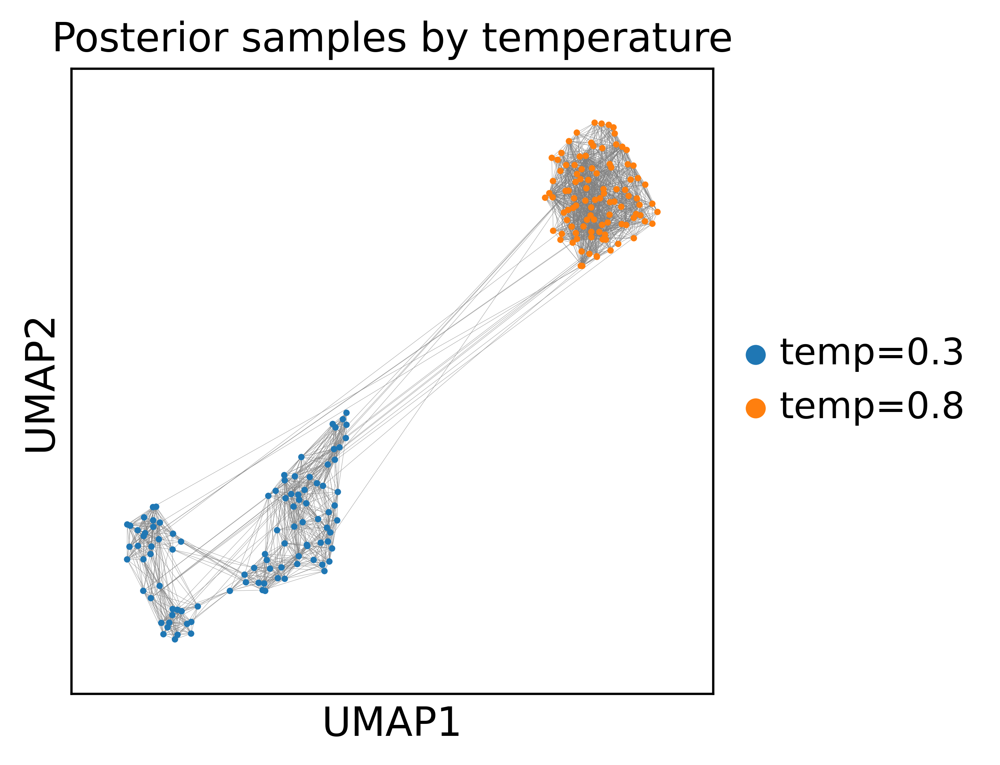

In [83]:
sc.pp.neighbors(concat_adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(concat_adata)
sc.pl.umap(
    concat_adata,
    color="temperature",
    size=20,
    title="Posterior samples by temperature",
    edges = True,
)

/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


[5. 4.]


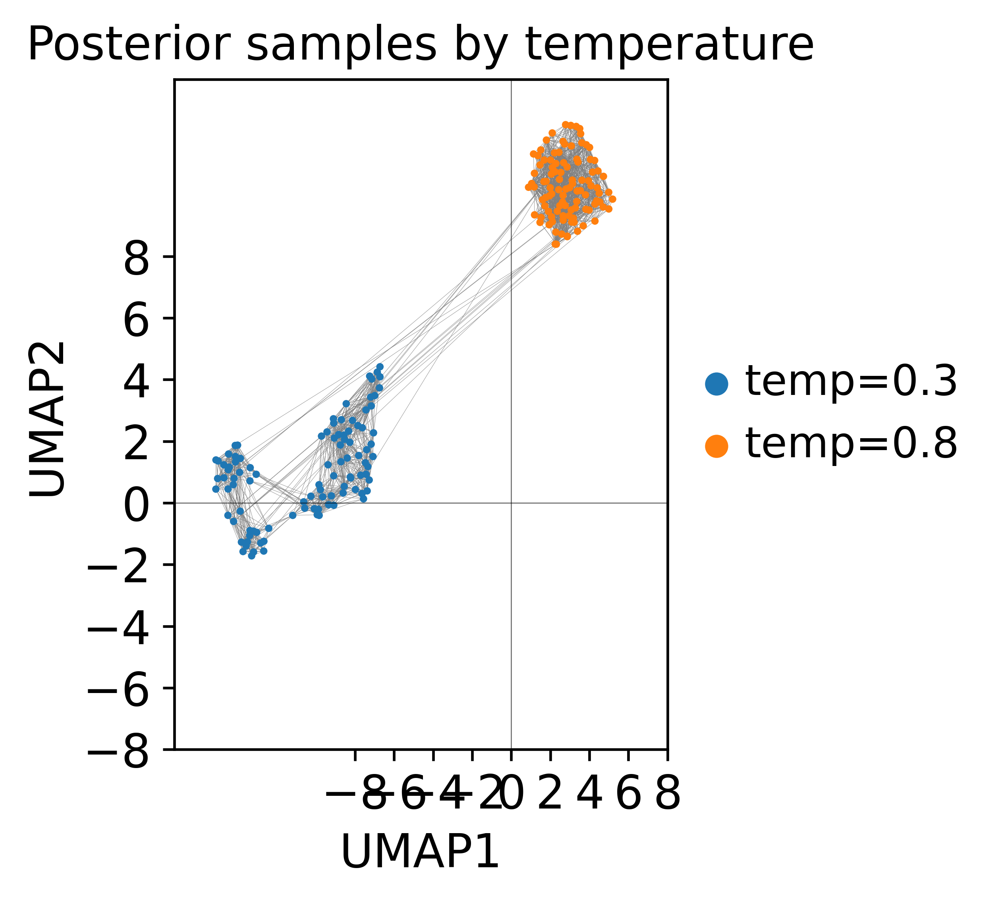

In [85]:
ax = sc.pl.umap(
    concat_adata,
    color="temperature",
    size=20,
    title="Posterior samples by temperature",
    edges = True,
    frameon=True, show=False,
)

# Force ticks/labels to display
ax.tick_params(axis="both", which="both", bottom=True, left=True, labelbottom=True, labelleft=True)
ax.set_xticks(np.arange(-8, 9, 2))
ax.set_yticks(np.arange(-8, 9, 2))
ax.set_xlabel("UMAP1")
ax.set_ylabel("UMAP2")

# Remove all gridlines (Scanpy/rcParams may enable them)
ax.grid(False)
# Draw ONLY the x=0 and y=0 lines
ax.axhline(0, color="black", linewidth=0.3, alpha=0.6, zorder=3) #control the visual order
ax.axvline(0, color="black", linewidth=0.3, alpha=0.6, zorder=3)

plt.tight_layout()

# save
fig = ax.figure
orig_size = fig.get_size_inches().copy()
fig.set_size_inches(5, 4)
# fig.savefig(
#     benchmarking_wd+"/umap_PosteriorSamplesByTemp.png",
#     dpi=500,
#     bbox_inches="tight"
# )

print(ax.figure.get_size_inches())
plt.show()

__Try 2: Union mask__

1. Post-process the posterior cell sentences
2. Contrast the number of unique genes in postprocessed posterior sentences sampled from two temps
    - __high temperature__ samples should have __larger mean__ number of unique genes [YES]
    - <mark>supports temperature is increasing posterior diversity</mark>

In [76]:
def get_postprocessingSentences(sentences, vocab_list, delimiter=" "):
    """
    return:
        1. ls_processed_sentences (list)
        2. after deduplication and limit to vocab_list, the number of *unique genes* in the processed cell sentence (list)
    """
    ls_processed_sentences = []
    numb_unique_genes = []
    
    for cell_sentence in sentences: 
        # Post-processing (tut5): clean up non-gene tokens and duplicates 
        processed_genes, _ = utils.post_process_generated_cell_sentences( 
            cell_sentence, 
            vocab_list=vocab_list, 
            replace_nonsense_string="NOT_A_GENE", 
        ) 
        processed_sentence = delimiter.join(processed_genes)
        processed_sentence = processed_sentence.replace(" NOT_A_GENE", "")
        
        # append processed sentences
        ls_processed_sentences.append(processed_sentence)

        # count unique genes (post_process... already de-dupes, but be explicit)
        ## check
        genes = [g for g in processed_genes if g != "NOT_A_GENE"]
        assert len(processed_sentence.split(delimiter)) == len(set(genes)), "Built-in de-dupes Failed."
        numb_unique_genes.append(len(set(genes)))

    return ls_processed_sentences, np.asarray(numb_unique_genes)

#### Apply ####
processed_high, numb_unique_genes_high = get_postprocessingSentences(meta["high_temp"]['posterior_samples'], vocab_list)
processed_low, numb_unique_genes_low  = get_postprocessingSentences(meta["low_temp"]['posterior_samples'],  vocab_list)

In [77]:
print(numb_unique_genes_high)
print(numb_unique_genes_low)

# #check
# print(len(processed_low[0].split(" ")))
# print(len(processed_low[1].split(" ")))
# print(len(processed_low[99].split(" ")))
# print(len(processed_high[0].split(" ")))
# print(len(processed_high[1].split(" ")))
# print(len(processed_high[99].split(" ")))

print("\nhigh-temp sampled processed sentence unique gene counts: mean", numb_unique_genes_high.mean(), "std", round(numb_unique_genes_high.std(),2))
print("low-temp sampled processed sentence unique gene counts: mean", numb_unique_genes_low.mean(),  "std", round(numb_unique_genes_low.std(),2))

[1605 1537 1570 1589 1595 1548 1546 1580 1519 1576 1514 1520 1566 1522
 1552 1567 1539 1593 1555 1557 1540 1585 1578 1551 1662 1529 1577 1525
 1608 1564 1585 1614 1600 1574 1648 1645 1583 1560 1548 1601 1555 1561
 1536 1572 1531 1620 1618 1606 1563 1536 1598 1549 1577 1561 1562 1502
 1556 1581 1566 1581 1554 1533 1514 1584 1617 1522 1538 1522 1533 1563
 1540 1613 1546 1562 1592 1547 1611 1580 1598 1531 1572 1585 1547 1544
 1534 1564 1557 1499 1571 1523 1596 1621 1587 1560 1607 1572 1606 1547
 1614 1546]
[1166 1176 1161 1172 1152 1166 1166 1160 1148 1174 1157 1151 1150 1166
 1187 1157 1157 1156 1159 1156 1158 1144 1160 1137 1159 1169 1204 1142
 1151 1146 1155 1155 1153 1138 1150 1139 1159 1155 1154 1193 1148 1115
 1159 1164 1142 1176 1172 1145 1143 1149 1160 1142 1154 1149 1153 1179
 1161 1161 1164 1177 1167 1142 1189 1163 1149 1147 1154 1162 1167 1173
 1135 1162 1148 1166 1145 1159 1187 1172 1145 1153 1162 1167 1159 1171
 1155 1175 1157 1159 1191 1172 1163 1198 1143 1166 1153 1184 1145

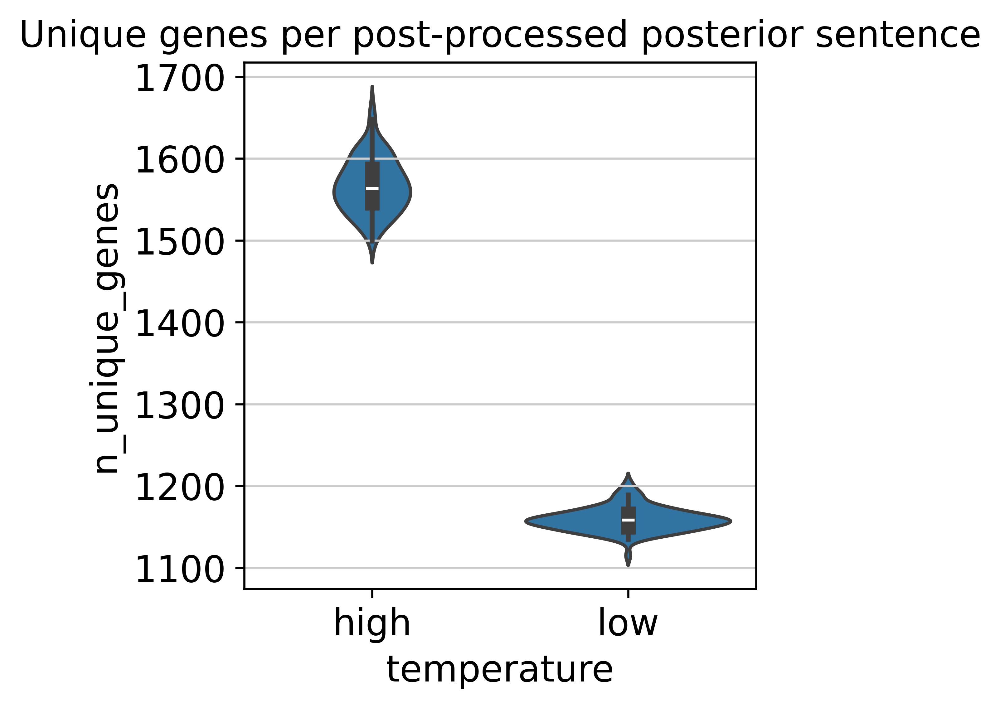

In [81]:
df = pd.DataFrame({
    "temperature": ["high"] * len(numb_unique_genes_high) + ["low"] * len(numb_unique_genes_low),
    "n_unique_genes": np.concatenate([numb_unique_genes_high, numb_unique_genes_low]),
})

sns.violinplot(data=df, x="temperature", y="n_unique_genes", inner="box")
plt.title("Unique genes per post-processed posterior sentence")
plt.tight_layout()
plt.show()

## **Reload the finetuned model and check the max context length --> truncate the generated cell sentence to a valid length

In [7]:
final_ckpt_path = "/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq/finetunedModel_2025-12-26-04_18_42_FullLengthFinetune_perturbation_prediction/checkpoint-36500"
save_dir        = "/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq"
finetuned_model = cs.CSModel(
    model_name_or_path=final_ckpt_path, # Path is updated after finetuning
    save_dir=save_dir,
    save_name="reload_perturbation_predictor_FullLengthFinetuned_final"
)

Using device: cpu


In [8]:
final_model = AutoModelForCausalLM.from_pretrained(
    finetuned_model.save_path,
    cache_dir=os.path.join(save_dir, ".cache"), #where to store / reuse model files
    trust_remote_code=True
).to(device)
# print(final_model)

In [10]:
# get the max context length
tok = finetuned_model.tokenizer
tok.model_max_length = final_model.config.max_position_embeddings
print(tok.model_max_length) #8192

inference_prompt = """
Given the following cell sentence of 2048 expressed genes representing a cell's basal state, predict the cell sentence after applying the perturbation: NELFE.
Control cell sentence: MALAT1 MT-CO3 MT-CO2 EEF1A1 RPL10 MT-ATP6 RPS2 RPS3A RPL13 GAPDH ACTB MT-CO1 RPS6 MT-CYB RPL6 PTMA RPS7 RPS23 TPT1 RPL19 RPS4X RPS19 RPL7A RACK1 MT-ND4 RPL18A RPL7 RPS12 RPS3 FTH1 RPS18 HSP90AA1 RPL3 RPS5 RPLP1 HMGB1 RPS27A RPL5 RPS14 TMSB4X RPL11 RPL9 RPS24 RPS15 RPLP0 TUBA1B RPL17 RPL18 RPL26 EEF1B2 RPS13 YBX1 RPL37 RPS16 RPL8 H3F3A RPL13A TUBB RPL15 RPS9 STMN1 RPL23A RPSA RPL28 MIF NCL NACA PPIA RPL41 NPM1 RPL21 RPL30 EEF1G RPL29 HMGN2 MT-ND1 RPS21 RPL24 RPS27 RPS8 H2AFZ ACTG1 HSP90AB1 RPLP2 RPL32 EIF4A1 HSPD1 CFL1 RPL10A HNRNPA1 HNRNPA2B1 CHCHD2 RPL35A HIST1H1D RPS15A SET ARHGDIB HNRNPD EIF1 FAU CALR BTF3 HIST1H4C RPL34 RAN RPL35 GNAS ANP32B MT-ND2 PFN1 RPL37A TYMS RPL27A GSTP1 PA2G4 SNHG29 RPL4 CD3D RPL36 TRBC1 RPL27 RPL12 NUCB2 RPL23 DUT HMGB2 RPS29 SUB1 HIST1H1B SRRM1 RPL39 HNRNPU RPS25 MT-ND3 RANBP1 RPL14 C1QBP HMGN1 SLC3A2 HINT1 PRDX1 NME2 HSPA8 EIF5A FTL CDK6 RPS28 HSPA9 CHI3L2 RPS26 LDHB CCT3 CCT6A SLC25A3 HSPE1 ARPC3 RPL22 EEF2 NDUFV2 ALYREF STIP1 CD99 HNRNPA3 RPS20 SELENOH UBA52 PABPC1 SRSF9 H3F3B ENO1 ATF4 CCT7 GADD45GIP1 PRDX5 CSNK1A1 XRCC5 LDHA B2M HIST1H1E PSMD8 TCP1 NOP53 FUS RPS17 COX4I1 SERF2 PSMA6 EIF3M RPS11 UBC H1FX SOD1 SOX4 RPL36A HNRNPAB CBX3 ATP5MC2 PSMA3 VIM CCT8 GUK1 RNASEH2B FABP5 PNN NDUFAB1 NAP1L1 PSMB6 HNRNPF TXNRD1 LSM2 EEF1D CENPV LUC7L2 RAD23A SRSF2 CCT2 SSB HNRNPK EIF3A PSAT1 CCT5 LEF1 EIF3K TPM3 SRRM2 COX5A RBM3 CHD4 EIF2S2 SUMO2 GTF3A DDX5 NDUFA4 ILF3 SYNE2 GYPC PFDN5 SARS PRRC2C DHFR EIF3D IGFBP2 C12ORF57 PTGES3 NUDC SEPTIN6 PNISR GNG5 UBXN1 GTPBP4 COX6A1 EIF3H H2AFV ROCK1 CORO1A SRM UBE2T SERP1 PSMC5 U2SURP MT-ND5 LCP1 PGLS PPDPF LCK RBBP4 UBE3A PARK7 PIN1 MT-ND6 HNRNPR LUC7L3 SNRPG SRP9 UBE2I SPNS3 PRELID1 ACP1 TPRKB NASP SRP14 MZB1 EDF1 RPS4Y1 KTN1 SLC25A6 UQCRH CLIC1 PSMD2 PSMA7 MDH2 TPI1 PCBP2 SF3B2 ANKRD11 DDX46 OAZ1 NDUFB8 SRSF4 TCEA1 RPS19BP1 RPA3 PSMB1 TARS SLC25A5 NDUFA13 KDM1A PTPRC ERH TRIR UBE2S KPNB1 PPP1R14B ATP5MC3 PPIG YTHDF2 ADA C11ORF58 SNRPD2 FYB1 ATP5PO MCM3 SNRPB CLPP TPR CUTA SRSF7 STAG2 COX6C SNRPF ARPC5 SRSF3 SEM1 DARS PPP1CA PHGDH PCBP1 EIF1AY YBX3 CARHSP1 SMC2 ATP5F1D PSMA4 TPM4 NDUFS6 DRAP1 BAZ1B MRPL58 RUNX1 TBCA NDUFB11 ADH5 MCM7 TOMM40 RTRAF MRPL21 LSM4 ATP5F1C MRTO4 SRSF10 SPC25 FXYD2 KHDRBS1 ARID4B PSMA5 PTPN7 ATP5IF1 YWHAE UXT LARS SRI PCNA HDAC1 ELOB HLA-A SMARCA4 HNRNPC LRRFIP1 MACF1 NDUFB3 EIF4G1 GDI2 SRSF1 PPA1 THRAP3 MYBL2 CDC123 COX5B DNAJC7 SNW1 MRPL18 DDX39B NDUFB10 EIF5 DEK CD1E SYNCRIP RPN2 LSM5 SLA MCM5 PSMD7 GAS5 CSDE1 ATP5MC1 TUBA1C TPX2 HINT2 ACADM MAGOH HSPB11 COX8A WDR3 USP7 UBE2G2 NDUFA11 NOL7 MYL6 COPS5 TOP1 CBX5 HNRNPH3 SEPTIN7 EIF5B SNRPN HNRNPDL SNHG7 RAC1 SFPQ CCDC167 EIF6 NONO EIF4G2 MICOS10 MRPS18C NUCKS1 POLD2 MYL12B PSMG2 AIF1 TOMM5 PDIA3 GTF2A2 HIST1H1C HNRNPM BUD31 SNHG6 SUPT16H RFC1 SRP72 PPP4R3A CENPU ADSL ATP5MG PSMD11 ARPC2 SERBP1 COX7A2 BRD7 NOP56 HSBP1 SMS SERINC5 RAD21 SUMO1 PSME1 SPTBN1 EZH2 DDX39A CCNI EPRS KIF5B NDUFS8 SSBP1 XAF1 ZNF22 RHEB APEX1 CYCS CSGALNACT2 C19ORF48 RBIS CYBA DNAJA1 RTN3 HSPH1 ARID5B NHP2 RAB5IF NME1 NDUFA7 HMGA1 C1ORF50 TSPAN7 DAXX KRR1 C17ORF49 VCP NEAT1 NDUFS5 MSN PGAM1 PAICS RSL1D1 DIAPH1 TMBIM6 SKP1 CANX ZNF207 UBE2D2 TMEM160 NUDT1 TMA16 UBB PAK2 SNRPD3 EIF3B BLOC1S1 TMEM123 CSNK2B PQBP1 BZW1 STRAP TMEM14B JTB NUP50 RSRC2 DNAJC9 VDAC2 SON GPBP1 PHB COPS3 HDAC2 BAZ1A SCP2 MZT2B FARSA DDX17 SRPK1 COPZ1 SNRPC MRPL51 ERVK3-1 TXN PCLAF ATP6V1G1 USP1 ITM2A BCLAF1 PGK1 SNHG5 PKM SSRP1 AP2S1 MAZ RBCK1 ELOC APIP DYNLL1 SNHG3 CD81 SF3B1 ELP5 SRP19 AP2M1 PSMG1 PHB2 RNASEK PHF5A FBL TFPT PRPF8 IARS CKLF MRPL3 DDX21 IMMT ZC3H13 MRPL14 PSMA2 EIF3F MTHFD2 RBM8A NDUFAF8 LPIN2 AIP RPS27L BABAM1 LRRFIP2 CBX1 ATP5MPL HSPA5 PSMC4 SMC3 RNF187 FKBP3 KIF2A RTN4 RTF1 SIVA1 BUB3 CAP1 NDUFB9 BCAT1 ATP5PD G3BP1 CCT4 CIRBP TUBB4B NDUFA8 GMFG CACYBP PSMD4 TRAPPC5 CDK1 VPS29 XRCC6 RBBP7 DNMT1 TXNL4A WDR70 ARF1 ATP5F1B SMARCC1 IFNAR1 CHMP2A NAE1 ACAP1 HIKESHI SMARCA5 TMEM208 CAPZB DKC1 SSR2 CHAF1A ZNRF1 PSMB3 SNRPE CNIH1 RBM17 WDR46 PUF60 ATP5F1A SNRPD1 ITGA4 TOMM6 TAF10 KIAA2013 NIPBL NUDT22 TOP2A SMARCD2 MED28 AHSA1 SUMO3 BAX NCAPG SMC4 ZFR PABPN1 MRPS7 CDC37 GPX4 NIFK DCTN2 UQCRFS1 HES4 SHMT2 NXT1 HSD17B10 KIF11 BOLA2 LMAN1 LRRCC1 SLC9A3R1 ANAPC11 TRAC VKORC1L1 DDX1 RABL6 BANF1 SF3B6 SLTM SRSF5 MYL12A ASPM THOC2 PUM1 ARPC5L KIF22 USF2 CYBC1 CD47 LIMD2 MRPL22 ZRANB2 ZKSCAN1 SAMD9 VDAC3 TIMM10 SRSF11 C9ORF16 RAE1 ASRGL1 CALU BSDC1 CHD9 SEC63 SUPV3L1 SNRNP200 RNH1 CALM2 NEIL3 C19ORF53 ST13 TATDN1 VPS28 AKR1A1 INTS10 TCERG1 DBI ARL2 SREK1 RBM39 CALM1 MTERF4 PSMB2 UGGT1 ODC1 CHD2 TRAPPC3 SNRNP70 ETF1 TMEM33 DNTTIP2 DR1 CCDC14 OSGEP UQCR10 LYPLA1 HIST1H2AH SMARCB1 SF3A3 ANP32E ZFAS1 SEC61B TM7SF3 EIF3E LSM1 HRAS IFI16 ACOT7 SNHG15 NDUFB5 EXOSC3 UTP11 C22ORF39 NKAPD1 SH3KBP1 PRKDC CHURC1 TRMT10C OGA SCCPDH TBC1D7 COA3 PCCB MZT2A EMC3 C21ORF58 MRPL20 PHIP ITM2B INO80E CRNDE ZNF512 TRMT112 NUSAP1 IDH3B HADHA PFKP EIF2S3 GSPT1 GRK6 BDP1 GPATCH4 KLHDC2 UBAC1 EXOSC8 MAD2L1 ZBTB17 PDAP1 TACC3 CDK5RAP3 ANXA2R TM9SF3 IMPDH2 NSMCE1 METTL9 EXOSC1 METTL18 HAUS5 RPL31 HDHD5 HIRIP3 RPL7L1 DCTN6 MRPL43 PITPNB MRPS34 RNF7 VPS26A NIP7 GAR1 RIOK2 NDUFA6 GUSB PARP1 MRPL11 GNPAT NCOR1 SREK1IP1 TXNL1 BRD4 FAM49B RPF1 KPNA2 EBNA1BP2 MPC2 DPF2 RBMX MYB AURKB EWSR1 VBP1 UBXN4 SNX17 PRPF38A DHX9 FYTTD1 PTBP3 BRIX1 ECHS1 ORAI2 FKBP1A POLR2F RFC5 PIAS1 MPP1 ACTR2 SMC6 TIGAR TOMM20 LYAR ARHGAP30 GNL2 TECR SUZ12 LUC7L TIPIN MOB4 METAP2 FAF1 CHORDC1 XPOT DAD1 CWC15 CENPH POMP PPP2R3B NEDD8 THOC7 HIGD2A FAT1 NAPA UBE2D3 ACTR3 NUP188 FAM174C GTF2I MTDH RNF130 FAM207A TMSB10 ZNF121 HDLBP TIAL1 TFDP1 MRPL2 ARGLU1 HAX1 C4ORF48 ARPC1A NRDC PSMD9 NSD2 UTP14A RBM25 TTC3 MRPL17 RBM4 COX7C ARNTL2 KIF2C SCAF11 MTHFD1 MIEF1 ATP5PF TMEM259 COX7B STAG1 YY1 ACIN1 IQGAP2 RPL38 CD320 NT5C DSTN HDGF EHMT2 ATP6V0E1 SMIM15 EXOSC10 BRCA2 CDCA7 DDX3X WIPI2 NSRP1 ESD NUBP2 CCDC124 RBM26 CIB1 LSM14A TSEN54 RNPS1 MRPL4 NDUFC2 METAP1 PRIM1 PSME2 NQO2 CHST12 USP14 RRP7A MGMT TNFRSF1A GABARAPL2 CCDC117 MAP4K4 ZNF638 NMI POLR2E LRPPRC SYPL1 FBRSL1 CTDNEP1 NAA20 ABCE1 ARID2 KNL1 DNAJC13 UBN1 OCIAD2 NUP85 ILF2 POP7 CD3E KRTCAP2 JPT1 MCM4 SMC5 NTMT1 PSIP1 AKIP1 POLR2G CTSC TNFAIP8 CDC26 PCNP METTL26 CKS1B CDT1 MTPN EIF1AX ADSS FTSJ3 EIF4A3 SF3B5 IQCB1 NT5C3B PRKAB1 HADHB PRPF19 SMG1 MED19 SDHD EIF2A MAP3K4 EIF3L CKS2 NOL12 TMEM50A FDPS EIF3I PRDX2 BLOC1S6 MYO7B TIMM17A STMP1 ZNF326 PRPF6 HOOK3 TMEM18 CEP295 NUDCD2 CUL2 LARP1B MAN2A1 AARSD1 IDH2 PSMB4 HELZ AGO2 ACSF3 PFDN2 RPA2 SQLE CHD1 PALM2-AKAP2 PPP2R2A PSMC3 SAP18 GNAQ UBE2V2 REXO2 UQCRC2 IWS1 TTF1 NDC80 EXOSC9 CHMP4A LAMTOR2 PRPF38B COPS6 NDUFV1 CUL3 CYC1 MFSD4B LSM3 CIAO2B UCHL3 MBIP MTREX CAPRIN1 ATP6V1F TMEM258 TKT UQCR11 GRIPAP1 YES1 PSENEN EIF4B ANKRD17 NTPCR UROD ATP5F1E CMPK1 PSMD13 TCF7L2 FIBP IPP R3HDM4 PRDX3 RPARP-AS1 APRT COA6 DCAF13 PRDX4 GINS2 INTS13 SARNP SART1 ANLN ARPP21 NGRN SIRT5 TIMM50 CPSF6 TBC1D15 REX1BD ERAP2 TARBP1 ASH1L MYCBP2 GRHPR EXOC7 SRD5A3 RAB29 CDK5 ANAPC16 CHTOP GGCT CHEK1 MRPL57 MCTS1 SLC1A5 APBB1IP CENPF MORF4L2 LMNB2 POLR2I YWHAB ZPR1 TMEM251 FBXO22 AK6 EFHD2 GLRX3 RMI1 PIM3 SSR4 NAPEPLD ANTKMT KNSTRN KCNAB2 STRBP ANKLE2 GLYR1 LAMTOR5 CEPT1 MRPS15 PRKAB2 QRSL1 TMEM11 FGD5-AS1 PNMA2 XPO1 FAM133B YDJC PANK2 PARP9 RNF149 REST COX6B1 UROS TLE5 NUDT21 FAM111B YIF1A PDIA6 MBNL1 CDC45 TTC5 SURF2 MYO1G CEBPB DCUN1D5 CEP85 MPLKIP MT-ND4L NDUFB4 PDE7A LSM8 DBT GABARAP MARS HTATSF1 SNX3 SBNO1 FAM118A VTI1B RHOA ZGPAT VPS16 NAPG HGS MICU2 RNMT SPOP DAZAP1 C2ORF76 OTUB1 ATP6V0C PSMD12 DGUOK ATP1B3 RFLNB ZWINT ERCC6L2 TSEN34 MAP3K2 RPP21 FLNA RBM27 TMX2 ZNF107 ARHGDIA TGOLN2 DFFA SLC35B2 FADS1 C12ORF75 TMEM179B TARDBP PRKRIP1 CIAO1 ZNF761 MSH3 SNX1 AC005670.3 NUP43 NRM MAGOHB CDC7 CPNE1 AIMP1 GADD45A SEPTIN11 PIEZO1 GOSR2 PDXP BRD1 INSIG1 MGA FDX1 CALCOCO2 ZBED3 TIMM13 EMC10 CUEDC2 TRAPPC13 SNHG12 RPS10 CAND1 DANCR ZNRD1 STX16 GIHCG CHST11 AC106791.1 SNHG17 VHL STAT1 RALBP1 EEA1 DYNLRB1 OSTC CEP192 TXNDC12 PHF20L1 DNASE2 COPS7B CLINT1 SUPT7L ANKHD1 GCC1 HERC5 BUD13 KLF13 TTF2 VPS36 TTC14 CAMK1D MRPL24 PRKCA C6ORF62 PPAN HSPA4 MTO1 UBE2E3 TMEM219 C1D CSE1L BLCAP EBPL PRELID3B CAPZA1 HPF1 RAC2 POLDIP3 BEX3 TTC21B CBFA2T3 TACO1 SLC16A1 ARHGEF6 UBA2 NELFE PSMD6 PMM1 POLD3 NTHL1 USP48 SPN R3HDM1 CLPTM1L FLAD1 TAF9 TUBG1 MEX3A PPP1R12A RNF5 CPT1A CMC2 ENSA NUTM2B-AS1 HMG20B SNX6 RWDD4 RPF2 CORO1B ATP5PB PCSK7 COX14 MRPL10 MRPS31 RBM48 MPHOSPH8 CCDC90B AARS MZT1 CDKN2D EFTUD2 HAUS3 SAV1 DUXAP8 AL021368.2 CCDC88A GLOD4 ATIC ANP32A HDGFL3 ENY2 ATP5ME ZNF480 TBCB HNRNPA0 CALM3 MRPS9 PRKCQ-AS1 AIMP2 COPS4 EXOC5 ZNF765 MRPL48 ZCRB1 ZC3H15 ASH2L TIPRL THUMPD1 AURKAIP1 ARL6IP1 DIMT1 PSMB7 NDUFS4 PHF20 ONECUT2 EXOSC2 KMT2B MIEN1 AAGAB ARMC10 CEP78 FNBP1 PSMC1 NDUFAF3 MTRF1L TMED3 ARMT1 MRPL13 PIAS2 C8ORF76 CCDC47 C16ORF95 NENF EPB41L2 MICB GALNT1 RAD50 SMARCAD1 LAPTM5 SLC35F5 CD2BP2 POLR3C MRPL16 PRR7 PPP2CA SNU13 ZNF44 CDC40 MELK BEX2 PPM1G SEC24B ADD3 OARD1 MOB1A LAGE3 TMEM203 PHPT1 MOGS ALDH9A1 IMP3 ATP6V1E1 PRORP RABAC1 GMEB1 ACO2 ZNF460 RAB2A POLR2L ATP6V0B OMA1 DUS3L GRPEL1 UFC1 ZNF330 B3GALT6 ITPA USP9X SLC25A37 HHIP STK39 RPL36AL PSPH PPP1R7 TOP2B SF3B3 DRG1 ALKBH4 TANK CTR9 ICMT PKN1 OGFR FAM217B RASA1 RSL24D1 BID TMX1 GPANK1 BCAP29 C1ORF35 PSMD14 SLC7A11 KIAA2026 QTRT1 NVL DDX6 KCMF1 TERF1 TMEM19 EIF3J PLEKHA5 RABGGTB KIF14 ARL3 FAM136A ABCF2 TSR1 TRAP1 ATP5MD SMARCE1 WDR1 EPHX2 UPF3B HAUS1 RGS19 VAPA HLTF RFC2 PSAP PLAA RER1 DDX24 POLR2H ACYP1 THAP5 CFAP97 UTP3 PRDX6 C17ORF97 ZCCHC4 THYN1 NUDT5 VPS25 IFT52 RWDD1 SDF2L1 AC002454.1 TYW1 YME1L1 IGHMBP2 IKZF1 GNB5 PUS7 OXLD1 NUDT3 SNHG20 GGNBP2 LTV1 SLIT1 LBR FAM76B DNAJC8 CBX6 DPM2 CLSPN TUT4 ZNF428 MAFG NCBP2AS2 USP16 SF1 CDC27 SDCBP EMG1 CPD AKAP1 HNRNPH1 ABRAXAS2 SMC1A GPS2 CD2 RAP1B CELF2 MRPL37 U2AF2 SLC29A1 ODF2 TOP3A E2F3 MRPL12 SPR TMEM161B-AS1 OTUD6B-AS1 FIP1L1 TAX1BP1 CLCN3 RRM1 ZNF32 CELF1 ICAM2 NUFIP2 NRN1 NANS LSM6 ZAP70 FAM98C CMIP BOD1L1 CSNK2A1 GTSE1 RPL26L1 SSNA1 TNRC6B CCNA2 BZW2 CEP350 MRPL52 EIF2B5 CHMP5 LSM7 LIAS XRN2 UQCRQ SHKBP1 HEXA LRRC28 TMCO1 SRPK2 PARP10 MRPS21 TRIM56 OCIAD1 PPIF VPS13C TIMM22 SGO2 SMAD5 COMMD4 SRSF6 ENOSF1 TEFM CENPW ISG15 LSM14B LIG1 CFDP1 AC009061.2 PRPF40A COX7A2L NSMAF MAD2L2 MRPS33 PSMA1 GFER BCAP31 RARS FAM111A RBM38 CDC25B LINC01128 JAKMIP1 BIN2 KARS RSPRY1 EIF4EBP2 GSK3A TMEM106C PCID2 AP1M1 HELLS DNAJB11 TM9SF2 FAM192A MRPL55 SURF6 GEMIN7 NSFL1C EEF1E1 YWHAQ MTCH2 LRRC58 GXYLT1 ATR AP1AR C17ORF75 TUBGCP2 PRADC1 NUDT8 TTC9C MCRIP2 RHOH GOLGA5 UBE2L6 ATP1A1 ELF1 TCOF1 FIS1 ATG4B DUS1L TP53I13 CDK13 BMS1 UBE2B MON2 PARD3 MTHFD1L EHMT1 SEPHS1 YLPM1 MYH10 MAT2A CNBP PDCD7 SUPT6H C12ORF73 EVL KAT6A MESD NDUFB7 TCF3 MPHOSPH10 THAP6 FXR1 SNHG16 BCS1L MLEC NOL8 NPC2 MTF2 TSNAX TMOD3 AP2B1 MRPL42 RAB6A AHCY DDOST ETFA PPP4R1 ZNF622 UTP6 PDS5A SUPT4H1 IGLL1 MAPKAPK5 RNF213 NAP1L4 KHDC4 EIF4G3 RNF168 NSUN5 ABHD3 SNRNP25 PPIB TRIM28 TXLNA TBL1XR1 RAP1GDS1 SLK SH2D1A SDAD1 DPP8 DCP2 CARS TASOR C4ORF3 AUTS2 ARHGEF1 CTCF RNASEH1 GNL3 PLEKHJ1 PAGR1 LINC01578 STOML2 STK17A ZNF281 ISY1 CYB5R3 MAP3K7 LSM12 LRRC41 PJA2 CYB5A ALG2 ROMO1 NOLC1 TAOK3 NCBP3 ETNK1 SLBP SAMD1 EIF3G CTSD UFM1 C1ORF112 ZNF146 ESF1 UQCRB KPNA3 LIMS1 GIGYF2 NOP14 SPAG7 NDUFB2 MRPL15 MRPL23 ATXN2L HCG18 LMO4 MON1B EIF2S1 EIF4A2 IDH3A PLRG1 SSU72 PABPC4 GTF3C2 PPIL4 CPSF3 NCOA3 BNIP2 NDUFA12 MCM6 CDV3 SAAL1 SEPTIN2 GLRX5 CD53 EMD ALG8 ZNRF2 GABPB1-AS1 VDAC1 RNF126 CKAP2 PEX10 MARCKSL1 FAM177A1 MLH1 THAP1 ZBED4 SDHC ATXN10 UHMK1 LIME1 TOMM22 UBE2N SERPINB8 MKI67 C6ORF136 HADH MED29 UBE2M ZNF217 DHX38 IPO5 JPX SPEN CMSS1 MRPL40 AHCTF1 WBP11 CD46 PRMT1 SETDB2 PRC1 CENPX TERF2IP GRB2 PAFAH1B3 MOCS2 TMEM116 SNAPC1 ACOT13 VMA21 NAA38 FAM222B XRCC2 ZNF33A BPNT1 KIF23 BOD1 SNAP29 NME4 PARN RIOK1 PIGP COPS2 MRPS23 RAC3 PYCR2 ERP29 NCAPH2 MTURN HELQ GANAB MLF2 CAPNS1 DDX23 GOLGA4 NUP62 ATOX1 TMEM134 PTGES2 CD164 ZFC3H1 SEH1L SPCS2 DERL1 ERCC1 FKBP4 RNASEH2C MIS18BP1 VPS41 PHF10 FNTA KIF15 WDR54 FES POLD1 DOHH PTTG1IP AC018647.2 BSG C8ORF82 CHCHD4 ASXL1 GOLT1B PAPOLA VPS50 SYF2 NDFIP1 DENND10 NSA2 UBP1 DNAJC21 ZBTB33 ZBTB48 GET1 SLC16A1-AS1 PISD POLR3GL ARG2 RFX3 SPRYD7 AP1S1 ATP13A3 EME1 ABCC1 SENP1 RTL10 OGFOD1 SUCLG1 CLDND1 HMOX2 DEGS1 NINL AL365295.1 UNC50 RAD51D DRAM2 SMG5 JUND FGFR1OP2 RAB3IP TMEM185B KMT2D RAD9A RAF1 KCTD13 MPDU1 ISCA2 LARP6 WIZ ZNF277 PEX2 ARL4A CFAP36 EMP3 PNKP HSPB1 MTX2 BNIP1 C4ORF46 B3GNT2 XPNPEP1 GLMN B4GAT1 DRG2 MRPL45 SMIM14 ATXN3 RPRD1B TMED2 ACBD3 CLIP1 SRA1 TJAP1 FASTKD1 LPCAT1 POLR2J3 ENDOD1 SNX11 PKN2 HSF2 PIK3CD-AS2 EIF4EBP1 CENPQ ALKBH7 CASC3 YWHAH USO1 ATXN7L3B FDX2 CFAP20 UBA5 ATF5 TNRC6C NHLRC2 HEBP2 LINC00342 EIF1B NPEPPS KANSL1-AS1 COPRS WDR74 AC009107.2 DNA2 SGO1 ZNF100 ABHD17A RFK NDST3 TRIOBP DYRK1A KIZ PEX26 ISOC2 FANCL SPG7 EEF2KMT LARP1 CCDC58 SEC23IP GOLGA7 PMS1 C12ORF66 MED23 RAB22A AZI2 EFL1 RAD51AP1 WDYHV1 PGD C2ORF69 COPS9 E2F7 COQ6 CD96 ZNF473 ADK SPCS3 ZNF526 CDK2AP2 COMMD6 PRKD3 CSK NUP93 NAF1 AGPAT5 CARMIL2 CIZ1 RBFOX2 SOS2 RALGAPB PSMB9 EIF4EBP3 XRCC4 SELENOT PTP4A2 TGS1 SDF4 NCBP1 INO80 ZMYM1 ACTR6 TRAF4 CPSF1 SEC11C GORASP2 SGCB TUBD1 POGK RWDD2B RING1 PPP4R3B TRIM8 CUL1 COPS7A ZNF292 TPGS1 GPBP1L1 MYC.

Perturbed cell sentence: 
"""
gene_only = "MALAT1 MT-CO3 MT-CO2 EEF1A1 RPL10 MT-ATP6 RPS2 RPS3A RPL13 GAPDH ACTB MT-CO1 RPS6 MT-CYB RPL6 PTMA RPS7 RPS23 TPT1 RPL19 RPS4X RPS19 RPL7A RACK1 MT-ND4 RPL18A RPL7 RPS12 RPS3 FTH1 RPS18 HSP90AA1 RPL3 RPS5 RPLP1 HMGB1 RPS27A RPL5 RPS14 TMSB4X RPL11 RPL9 RPS24 RPS15 RPLP0 TUBA1B RPL17 RPL18 RPL26 EEF1B2 RPS13 YBX1 RPL37 RPS16 RPL8 H3F3A RPL13A TUBB RPL15 RPS9 STMN1 RPL23A RPSA RPL28 MIF NCL NACA PPIA RPL41 NPM1 RPL21 RPL30 EEF1G RPL29 HMGN2 MT-ND1 RPS21 RPL24 RPS27 RPS8 H2AFZ ACTG1 HSP90AB1 RPLP2 RPL32 EIF4A1 HSPD1 CFL1 RPL10A HNRNPA1 HNRNPA2B1 CHCHD2 RPL35A HIST1H1D RPS15A SET ARHGDIB HNRNPD EIF1 FAU CALR BTF3 HIST1H4C RPL34 RAN RPL35 GNAS ANP32B MT-ND2 PFN1 RPL37A TYMS RPL27A GSTP1 PA2G4 SNHG29 RPL4 CD3D RPL36 TRBC1 RPL27 RPL12 NUCB2 RPL23 DUT HMGB2 RPS29 SUB1 HIST1H1B SRRM1 RPL39 HNRNPU RPS25 MT-ND3 RANBP1 RPL14 C1QBP HMGN1 SLC3A2 HINT1 PRDX1 NME2 HSPA8 EIF5A FTL CDK6 RPS28 HSPA9 CHI3L2 RPS26 LDHB CCT3 CCT6A SLC25A3 HSPE1 ARPC3 RPL22 EEF2 NDUFV2 ALYREF STIP1 CD99 HNRNPA3 RPS20 SELENOH UBA52 PABPC1 SRSF9 H3F3B ENO1 ATF4 CCT7 GADD45GIP1 PRDX5 CSNK1A1 XRCC5 LDHA B2M HIST1H1E PSMD8 TCP1 NOP53 FUS RPS17 COX4I1 SERF2 PSMA6 EIF3M RPS11 UBC H1FX SOD1 SOX4 RPL36A HNRNPAB CBX3 ATP5MC2 PSMA3 VIM CCT8 GUK1 RNASEH2B FABP5 PNN NDUFAB1 NAP1L1 PSMB6 HNRNPF TXNRD1 LSM2 EEF1D CENPV LUC7L2 RAD23A SRSF2 CCT2 SSB HNRNPK EIF3A PSAT1 CCT5 LEF1 EIF3K TPM3 SRRM2 COX5A RBM3 CHD4 EIF2S2 SUMO2 GTF3A DDX5 NDUFA4 ILF3 SYNE2 GYPC PFDN5 SARS PRRC2C DHFR EIF3D IGFBP2 C12ORF57 PTGES3 NUDC SEPTIN6 PNISR GNG5 UBXN1 GTPBP4 COX6A1 EIF3H H2AFV ROCK1 CORO1A SRM UBE2T SERP1 PSMC5 U2SURP MT-ND5 LCP1 PGLS PPDPF LCK RBBP4 UBE3A PARK7 PIN1 MT-ND6 HNRNPR LUC7L3 SNRPG SRP9 UBE2I SPNS3 PRELID1 ACP1 TPRKB NASP SRP14 MZB1 EDF1 RPS4Y1 KTN1 SLC25A6 UQCRH CLIC1 PSMD2 PSMA7 MDH2 TPI1 PCBP2 SF3B2 ANKRD11 DDX46 OAZ1 NDUFB8 SRSF4 TCEA1 RPS19BP1 RPA3 PSMB1 TARS SLC25A5 NDUFA13 KDM1A PTPRC ERH TRIR UBE2S KPNB1 PPP1R14B ATP5MC3 PPIG YTHDF2 ADA C11ORF58 SNRPD2 FYB1 ATP5PO MCM3 SNRPB CLPP TPR CUTA SRSF7 STAG2 COX6C SNRPF ARPC5 SRSF3 SEM1 DARS PPP1CA PHGDH PCBP1 EIF1AY YBX3 CARHSP1 SMC2 ATP5F1D PSMA4 TPM4 NDUFS6 DRAP1 BAZ1B MRPL58 RUNX1 TBCA NDUFB11 ADH5 MCM7 TOMM40 RTRAF MRPL21 LSM4 ATP5F1C MRTO4 SRSF10 SPC25 FXYD2 KHDRBS1 ARID4B PSMA5 PTPN7 ATP5IF1 YWHAE UXT LARS SRI PCNA HDAC1 ELOB HLA-A SMARCA4 HNRNPC LRRFIP1 MACF1 NDUFB3 EIF4G1 GDI2 SRSF1 PPA1 THRAP3 MYBL2 CDC123 COX5B DNAJC7 SNW1 MRPL18 DDX39B NDUFB10 EIF5 DEK CD1E SYNCRIP RPN2 LSM5 SLA MCM5 PSMD7 GAS5 CSDE1 ATP5MC1 TUBA1C TPX2 HINT2 ACADM MAGOH HSPB11 COX8A WDR3 USP7 UBE2G2 NDUFA11 NOL7 MYL6 COPS5 TOP1 CBX5 HNRNPH3 SEPTIN7 EIF5B SNRPN HNRNPDL SNHG7 RAC1 SFPQ CCDC167 EIF6 NONO EIF4G2 MICOS10 MRPS18C NUCKS1 POLD2 MYL12B PSMG2 AIF1 TOMM5 PDIA3 GTF2A2 HIST1H1C HNRNPM BUD31 SNHG6 SUPT16H RFC1 SRP72 PPP4R3A CENPU ADSL ATP5MG PSMD11 ARPC2 SERBP1 COX7A2 BRD7 NOP56 HSBP1 SMS SERINC5 RAD21 SUMO1 PSME1 SPTBN1 EZH2 DDX39A CCNI EPRS KIF5B NDUFS8 SSBP1 XAF1 ZNF22 RHEB APEX1 CYCS CSGALNACT2 C19ORF48 RBIS CYBA DNAJA1 RTN3 HSPH1 ARID5B NHP2 RAB5IF NME1 NDUFA7 HMGA1 C1ORF50 TSPAN7 DAXX KRR1 C17ORF49 VCP NEAT1 NDUFS5 MSN PGAM1 PAICS RSL1D1 DIAPH1 TMBIM6 SKP1 CANX ZNF207 UBE2D2 TMEM160 NUDT1 TMA16 UBB PAK2 SNRPD3 EIF3B BLOC1S1 TMEM123 CSNK2B PQBP1 BZW1 STRAP TMEM14B JTB NUP50 RSRC2 DNAJC9 VDAC2 SON GPBP1 PHB COPS3 HDAC2 BAZ1A SCP2 MZT2B FARSA DDX17 SRPK1 COPZ1 SNRPC MRPL51 ERVK3-1 TXN PCLAF ATP6V1G1 USP1 ITM2A BCLAF1 PGK1 SNHG5 PKM SSRP1 AP2S1 MAZ RBCK1 ELOC APIP DYNLL1 SNHG3 CD81 SF3B1 ELP5 SRP19 AP2M1 PSMG1 PHB2 RNASEK PHF5A FBL TFPT PRPF8 IARS CKLF MRPL3 DDX21 IMMT ZC3H13 MRPL14 PSMA2 EIF3F MTHFD2 RBM8A NDUFAF8 LPIN2 AIP RPS27L BABAM1 LRRFIP2 CBX1 ATP5MPL HSPA5 PSMC4 SMC3 RNF187 FKBP3 KIF2A RTN4 RTF1 SIVA1 BUB3 CAP1 NDUFB9 BCAT1 ATP5PD G3BP1 CCT4 CIRBP TUBB4B NDUFA8 GMFG CACYBP PSMD4 TRAPPC5 CDK1 VPS29 XRCC6 RBBP7 DNMT1 TXNL4A WDR70 ARF1 ATP5F1B SMARCC1 IFNAR1 CHMP2A NAE1 ACAP1 HIKESHI SMARCA5 TMEM208 CAPZB DKC1 SSR2 CHAF1A ZNRF1 PSMB3 SNRPE CNIH1 RBM17 WDR46 PUF60 ATP5F1A SNRPD1 ITGA4 TOMM6 TAF10 KIAA2013 NIPBL NUDT22 TOP2A SMARCD2 MED28 AHSA1 SUMO3 BAX NCAPG SMC4 ZFR PABPN1 MRPS7 CDC37 GPX4 NIFK DCTN2 UQCRFS1 HES4 SHMT2 NXT1 HSD17B10 KIF11 BOLA2 LMAN1 LRRCC1 SLC9A3R1 ANAPC11 TRAC VKORC1L1 DDX1 RABL6 BANF1 SF3B6 SLTM SRSF5 MYL12A ASPM THOC2 PUM1 ARPC5L KIF22 USF2 CYBC1 CD47 LIMD2 MRPL22 ZRANB2 ZKSCAN1 SAMD9 VDAC3 TIMM10 SRSF11 C9ORF16 RAE1 ASRGL1 CALU BSDC1 CHD9 SEC63 SUPV3L1 SNRNP200 RNH1 CALM2 NEIL3 C19ORF53 ST13 TATDN1 VPS28 AKR1A1 INTS10 TCERG1 DBI ARL2 SREK1 RBM39 CALM1 MTERF4 PSMB2 UGGT1 ODC1 CHD2 TRAPPC3 SNRNP70 ETF1 TMEM33 DNTTIP2 DR1 CCDC14 OSGEP UQCR10 LYPLA1 HIST1H2AH SMARCB1 SF3A3 ANP32E ZFAS1 SEC61B TM7SF3 EIF3E LSM1 HRAS IFI16 ACOT7 SNHG15 NDUFB5 EXOSC3 UTP11 C22ORF39 NKAPD1 SH3KBP1 PRKDC CHURC1 TRMT10C OGA SCCPDH TBC1D7 COA3 PCCB MZT2A EMC3 C21ORF58 MRPL20 PHIP ITM2B INO80E CRNDE ZNF512 TRMT112 NUSAP1 IDH3B HADHA PFKP EIF2S3 GSPT1 GRK6 BDP1 GPATCH4 KLHDC2 UBAC1 EXOSC8 MAD2L1 ZBTB17 PDAP1 TACC3 CDK5RAP3 ANXA2R TM9SF3 IMPDH2 NSMCE1 METTL9 EXOSC1 METTL18 HAUS5 RPL31 HDHD5 HIRIP3 RPL7L1 DCTN6 MRPL43 PITPNB MRPS34 RNF7 VPS26A NIP7 GAR1 RIOK2 NDUFA6 GUSB PARP1 MRPL11 GNPAT NCOR1 SREK1IP1 TXNL1 BRD4 FAM49B RPF1 KPNA2 EBNA1BP2 MPC2 DPF2 RBMX MYB AURKB EWSR1 VBP1 UBXN4 SNX17 PRPF38A DHX9 FYTTD1 PTBP3 BRIX1 ECHS1 ORAI2 FKBP1A POLR2F RFC5 PIAS1 MPP1 ACTR2 SMC6 TIGAR TOMM20 LYAR ARHGAP30 GNL2 TECR SUZ12 LUC7L TIPIN MOB4 METAP2 FAF1 CHORDC1 XPOT DAD1 CWC15 CENPH POMP PPP2R3B NEDD8 THOC7 HIGD2A FAT1 NAPA UBE2D3 ACTR3 NUP188 FAM174C GTF2I MTDH RNF130 FAM207A TMSB10 ZNF121 HDLBP TIAL1 TFDP1 MRPL2 ARGLU1 HAX1 C4ORF48 ARPC1A NRDC PSMD9 NSD2 UTP14A RBM25 TTC3 MRPL17 RBM4 COX7C ARNTL2 KIF2C SCAF11 MTHFD1 MIEF1 ATP5PF TMEM259 COX7B STAG1 YY1 ACIN1 IQGAP2 RPL38 CD320 NT5C DSTN HDGF EHMT2 ATP6V0E1 SMIM15 EXOSC10 BRCA2 CDCA7 DDX3X WIPI2 NSRP1 ESD NUBP2 CCDC124 RBM26 CIB1 LSM14A TSEN54 RNPS1 MRPL4 NDUFC2 METAP1 PRIM1 PSME2 NQO2 CHST12 USP14 RRP7A MGMT TNFRSF1A GABARAPL2 CCDC117 MAP4K4 ZNF638 NMI POLR2E LRPPRC SYPL1 FBRSL1 CTDNEP1 NAA20 ABCE1 ARID2 KNL1 DNAJC13 UBN1 OCIAD2 NUP85 ILF2 POP7 CD3E KRTCAP2 JPT1 MCM4 SMC5 NTMT1 PSIP1 AKIP1 POLR2G CTSC TNFAIP8 CDC26 PCNP METTL26 CKS1B CDT1 MTPN EIF1AX ADSS FTSJ3 EIF4A3 SF3B5 IQCB1 NT5C3B PRKAB1 HADHB PRPF19 SMG1 MED19 SDHD EIF2A MAP3K4 EIF3L CKS2 NOL12 TMEM50A FDPS EIF3I PRDX2 BLOC1S6 MYO7B TIMM17A STMP1 ZNF326 PRPF6 HOOK3 TMEM18 CEP295 NUDCD2 CUL2 LARP1B MAN2A1 AARSD1 IDH2 PSMB4 HELZ AGO2 ACSF3 PFDN2 RPA2 SQLE CHD1 PALM2-AKAP2 PPP2R2A PSMC3 SAP18 GNAQ UBE2V2 REXO2 UQCRC2 IWS1 TTF1 NDC80 EXOSC9 CHMP4A LAMTOR2 PRPF38B COPS6 NDUFV1 CUL3 CYC1 MFSD4B LSM3 CIAO2B UCHL3 MBIP MTREX CAPRIN1 ATP6V1F TMEM258 TKT UQCR11 GRIPAP1 YES1 PSENEN EIF4B ANKRD17 NTPCR UROD ATP5F1E CMPK1 PSMD13 TCF7L2 FIBP IPP R3HDM4 PRDX3 RPARP-AS1 APRT COA6 DCAF13 PRDX4 GINS2 INTS13 SARNP SART1 ANLN ARPP21 NGRN SIRT5 TIMM50 CPSF6 TBC1D15 REX1BD ERAP2 TARBP1 ASH1L MYCBP2 GRHPR EXOC7 SRD5A3 RAB29 CDK5 ANAPC16 CHTOP GGCT CHEK1 MRPL57 MCTS1 SLC1A5 APBB1IP CENPF MORF4L2 LMNB2 POLR2I YWHAB ZPR1 TMEM251 FBXO22 AK6 EFHD2 GLRX3 RMI1 PIM3 SSR4 NAPEPLD ANTKMT KNSTRN KCNAB2 STRBP ANKLE2 GLYR1 LAMTOR5 CEPT1 MRPS15 PRKAB2 QRSL1 TMEM11 FGD5-AS1 PNMA2 XPO1 FAM133B YDJC PANK2 PARP9 RNF149 REST COX6B1 UROS TLE5 NUDT21 FAM111B YIF1A PDIA6 MBNL1 CDC45 TTC5 SURF2 MYO1G CEBPB DCUN1D5 CEP85 MPLKIP MT-ND4L NDUFB4 PDE7A LSM8 DBT GABARAP MARS HTATSF1 SNX3 SBNO1 FAM118A VTI1B RHOA ZGPAT VPS16 NAPG HGS MICU2 RNMT SPOP DAZAP1 C2ORF76 OTUB1 ATP6V0C PSMD12 DGUOK ATP1B3 RFLNB ZWINT ERCC6L2 TSEN34 MAP3K2 RPP21 FLNA RBM27 TMX2 ZNF107 ARHGDIA TGOLN2 DFFA SLC35B2 FADS1 C12ORF75 TMEM179B TARDBP PRKRIP1 CIAO1 ZNF761 MSH3 SNX1 AC005670.3 NUP43 NRM MAGOHB CDC7 CPNE1 AIMP1 GADD45A SEPTIN11 PIEZO1 GOSR2 PDXP BRD1 INSIG1 MGA FDX1 CALCOCO2 ZBED3 TIMM13 EMC10 CUEDC2 TRAPPC13 SNHG12 RPS10 CAND1 DANCR ZNRD1 STX16 GIHCG CHST11 AC106791.1 SNHG17 VHL STAT1 RALBP1 EEA1 DYNLRB1 OSTC CEP192 TXNDC12 PHF20L1 DNASE2 COPS7B CLINT1 SUPT7L ANKHD1 GCC1 HERC5 BUD13 KLF13 TTF2 VPS36 TTC14 CAMK1D MRPL24 PRKCA C6ORF62 PPAN HSPA4 MTO1 UBE2E3 TMEM219 C1D CSE1L BLCAP EBPL PRELID3B CAPZA1 HPF1 RAC2 POLDIP3 BEX3 TTC21B CBFA2T3 TACO1 SLC16A1 ARHGEF6 UBA2 NELFE PSMD6 PMM1 POLD3 NTHL1 USP48 SPN R3HDM1 CLPTM1L FLAD1 TAF9 TUBG1 MEX3A PPP1R12A RNF5 CPT1A CMC2 ENSA NUTM2B-AS1 HMG20B SNX6 RWDD4 RPF2 CORO1B ATP5PB PCSK7 COX14 MRPL10 MRPS31 RBM48 MPHOSPH8 CCDC90B AARS MZT1 CDKN2D EFTUD2 HAUS3 SAV1 DUXAP8 AL021368.2 CCDC88A GLOD4 ATIC ANP32A HDGFL3 ENY2 ATP5ME ZNF480 TBCB HNRNPA0 CALM3 MRPS9 PRKCQ-AS1 AIMP2 COPS4 EXOC5 ZNF765 MRPL48 ZCRB1 ZC3H15 ASH2L TIPRL THUMPD1 AURKAIP1 ARL6IP1 DIMT1 PSMB7 NDUFS4 PHF20 ONECUT2 EXOSC2 KMT2B MIEN1 AAGAB ARMC10 CEP78 FNBP1 PSMC1 NDUFAF3 MTRF1L TMED3 ARMT1 MRPL13 PIAS2 C8ORF76 CCDC47 C16ORF95 NENF EPB41L2 MICB GALNT1 RAD50 SMARCAD1 LAPTM5 SLC35F5 CD2BP2 POLR3C MRPL16 PRR7 PPP2CA SNU13 ZNF44 CDC40 MELK BEX2 PPM1G SEC24B ADD3 OARD1 MOB1A LAGE3 TMEM203 PHPT1 MOGS ALDH9A1 IMP3 ATP6V1E1 PRORP RABAC1 GMEB1 ACO2 ZNF460 RAB2A POLR2L ATP6V0B OMA1 DUS3L GRPEL1 UFC1 ZNF330 B3GALT6 ITPA USP9X SLC25A37 HHIP STK39 RPL36AL PSPH PPP1R7 TOP2B SF3B3 DRG1 ALKBH4 TANK CTR9 ICMT PKN1 OGFR FAM217B RASA1 RSL24D1 BID TMX1 GPANK1 BCAP29 C1ORF35 PSMD14 SLC7A11 KIAA2026 QTRT1 NVL DDX6 KCMF1 TERF1 TMEM19 EIF3J PLEKHA5 RABGGTB KIF14 ARL3 FAM136A ABCF2 TSR1 TRAP1 ATP5MD SMARCE1 WDR1 EPHX2 UPF3B HAUS1 RGS19 VAPA HLTF RFC2 PSAP PLAA RER1 DDX24 POLR2H ACYP1 THAP5 CFAP97 UTP3 PRDX6 C17ORF97 ZCCHC4 THYN1 NUDT5 VPS25 IFT52 RWDD1 SDF2L1 AC002454.1 TYW1 YME1L1 IGHMBP2 IKZF1 GNB5 PUS7 OXLD1 NUDT3 SNHG20 GGNBP2 LTV1 SLIT1 LBR FAM76B DNAJC8 CBX6 DPM2 CLSPN TUT4 ZNF428 MAFG NCBP2AS2 USP16 SF1 CDC27 SDCBP EMG1 CPD AKAP1 HNRNPH1 ABRAXAS2 SMC1A GPS2 CD2 RAP1B CELF2 MRPL37 U2AF2 SLC29A1 ODF2 TOP3A E2F3 MRPL12 SPR TMEM161B-AS1 OTUD6B-AS1 FIP1L1 TAX1BP1 CLCN3 RRM1 ZNF32 CELF1 ICAM2 NUFIP2 NRN1 NANS LSM6 ZAP70 FAM98C CMIP BOD1L1 CSNK2A1 GTSE1 RPL26L1 SSNA1 TNRC6B CCNA2 BZW2 CEP350 MRPL52 EIF2B5 CHMP5 LSM7 LIAS XRN2 UQCRQ SHKBP1 HEXA LRRC28 TMCO1 SRPK2 PARP10 MRPS21 TRIM56 OCIAD1 PPIF VPS13C TIMM22 SGO2 SMAD5 COMMD4 SRSF6 ENOSF1 TEFM CENPW ISG15 LSM14B LIG1 CFDP1 AC009061.2 PRPF40A COX7A2L NSMAF MAD2L2 MRPS33 PSMA1 GFER BCAP31 RARS FAM111A RBM38 CDC25B LINC01128 JAKMIP1 BIN2 KARS RSPRY1 EIF4EBP2 GSK3A TMEM106C PCID2 AP1M1 HELLS DNAJB11 TM9SF2 FAM192A MRPL55 SURF6 GEMIN7 NSFL1C EEF1E1 YWHAQ MTCH2 LRRC58 GXYLT1 ATR AP1AR C17ORF75 TUBGCP2 PRADC1 NUDT8 TTC9C MCRIP2 RHOH GOLGA5 UBE2L6 ATP1A1 ELF1 TCOF1 FIS1 ATG4B DUS1L TP53I13 CDK13 BMS1 UBE2B MON2 PARD3 MTHFD1L EHMT1 SEPHS1 YLPM1 MYH10 MAT2A CNBP PDCD7 SUPT6H C12ORF73 EVL KAT6A MESD NDUFB7 TCF3 MPHOSPH10 THAP6 FXR1 SNHG16 BCS1L MLEC NOL8 NPC2 MTF2 TSNAX TMOD3 AP2B1 MRPL42 RAB6A AHCY DDOST ETFA PPP4R1 ZNF622 UTP6 PDS5A SUPT4H1 IGLL1 MAPKAPK5 RNF213 NAP1L4 KHDC4 EIF4G3 RNF168 NSUN5 ABHD3 SNRNP25 PPIB TRIM28 TXLNA TBL1XR1 RAP1GDS1 SLK SH2D1A SDAD1 DPP8 DCP2 CARS TASOR C4ORF3 AUTS2 ARHGEF1 CTCF RNASEH1 GNL3 PLEKHJ1 PAGR1 LINC01578 STOML2 STK17A ZNF281 ISY1 CYB5R3 MAP3K7 LSM12 LRRC41 PJA2 CYB5A ALG2 ROMO1 NOLC1 TAOK3 NCBP3 ETNK1 SLBP SAMD1 EIF3G CTSD UFM1 C1ORF112 ZNF146 ESF1 UQCRB KPNA3 LIMS1 GIGYF2 NOP14 SPAG7 NDUFB2 MRPL15 MRPL23 ATXN2L HCG18 LMO4 MON1B EIF2S1 EIF4A2 IDH3A PLRG1 SSU72 PABPC4 GTF3C2 PPIL4 CPSF3 NCOA3 BNIP2 NDUFA12 MCM6 CDV3 SAAL1 SEPTIN2 GLRX5 CD53 EMD ALG8 ZNRF2 GABPB1-AS1 VDAC1 RNF126 CKAP2 PEX10 MARCKSL1 FAM177A1 MLH1 THAP1 ZBED4 SDHC ATXN10 UHMK1 LIME1 TOMM22 UBE2N SERPINB8 MKI67 C6ORF136 HADH MED29 UBE2M ZNF217 DHX38 IPO5 JPX SPEN CMSS1 MRPL40 AHCTF1 WBP11 CD46 PRMT1 SETDB2 PRC1 CENPX TERF2IP GRB2 PAFAH1B3 MOCS2 TMEM116 SNAPC1 ACOT13 VMA21 NAA38 FAM222B XRCC2 ZNF33A BPNT1 KIF23 BOD1 SNAP29 NME4 PARN RIOK1 PIGP COPS2 MRPS23 RAC3 PYCR2 ERP29 NCAPH2 MTURN HELQ GANAB MLF2 CAPNS1 DDX23 GOLGA4 NUP62 ATOX1 TMEM134 PTGES2 CD164 ZFC3H1 SEH1L SPCS2 DERL1 ERCC1 FKBP4 RNASEH2C MIS18BP1 VPS41 PHF10 FNTA KIF15 WDR54 FES POLD1 DOHH PTTG1IP AC018647.2 BSG C8ORF82 CHCHD4 ASXL1 GOLT1B PAPOLA VPS50 SYF2 NDFIP1 DENND10 NSA2 UBP1 DNAJC21 ZBTB33 ZBTB48 GET1 SLC16A1-AS1 PISD POLR3GL ARG2 RFX3 SPRYD7 AP1S1 ATP13A3 EME1 ABCC1 SENP1 RTL10 OGFOD1 SUCLG1 CLDND1 HMOX2 DEGS1 NINL AL365295.1 UNC50 RAD51D DRAM2 SMG5 JUND FGFR1OP2 RAB3IP TMEM185B KMT2D RAD9A RAF1 KCTD13 MPDU1 ISCA2 LARP6 WIZ ZNF277 PEX2 ARL4A CFAP36 EMP3 PNKP HSPB1 MTX2 BNIP1 C4ORF46 B3GNT2 XPNPEP1 GLMN B4GAT1 DRG2 MRPL45 SMIM14 ATXN3 RPRD1B TMED2 ACBD3 CLIP1 SRA1 TJAP1 FASTKD1 LPCAT1 POLR2J3 ENDOD1 SNX11 PKN2 HSF2 PIK3CD-AS2 EIF4EBP1 CENPQ ALKBH7 CASC3 YWHAH USO1 ATXN7L3B FDX2 CFAP20 UBA5 ATF5 TNRC6C NHLRC2 HEBP2 LINC00342 EIF1B NPEPPS KANSL1-AS1 COPRS WDR74 AC009107.2 DNA2 SGO1 ZNF100 ABHD17A RFK NDST3 TRIOBP DYRK1A KIZ PEX26 ISOC2 FANCL SPG7 EEF2KMT LARP1 CCDC58 SEC23IP GOLGA7 PMS1 C12ORF66 MED23 RAB22A AZI2 EFL1 RAD51AP1 WDYHV1 PGD C2ORF69 COPS9 E2F7 COQ6 CD96 ZNF473 ADK SPCS3 ZNF526 CDK2AP2 COMMD6 PRKD3 CSK NUP93 NAF1 AGPAT5 CARMIL2 CIZ1 RBFOX2 SOS2 RALGAPB PSMB9 EIF4EBP3 XRCC4 SELENOT PTP4A2 TGS1 SDF4 NCBP1 INO80 ZMYM1 ACTR6 TRAF4 CPSF1 SEC11C GORASP2 SGCB TUBD1 POGK RWDD2B RING1 PPP4R3B TRIM8 CUL1 COPS7A ZNF292 TPGS1 GPBP1L1 MYC."
output_sentence = meta["high_temp"]['posterior_samples'][4]

# Check prompt token size
prompt_ids = tok(inference_prompt, add_special_tokens=False)["input_ids"]
prompt_len = len(prompt_ids)
print(prompt_len) #7015

# Check output token size
output_ids = tok(output_sentence, add_special_tokens=False)["input_ids"]
output_len = len(output_ids)
print(output_len) #8192

# Check safe output token size
safety = 64
max_new = max(0, tok.model_max_length - prompt_len - safety) #max_new_tokens: 1113
print("prompt_len_tokens:", prompt_len, "model_max:", tok.model_max_length, "max_new_tokens:", max_new)

8192
7015
8192
prompt_len_tokens: 7015 model_max: 8192 max_new_tokens: 1113


In [86]:
def truncate_to_k_tokens(text: str, tok, k: int) -> str:
    ids = tok(text, add_special_tokens=False)["input_ids"][:k]
    return tok.decode(ids, skip_special_tokens=True)

# high temp
truncated_high_temp_posterior_samples = []
for cell_sentence in meta["high_temp"]['posterior_samples']:
    truncated = truncate_to_k_tokens(text = cell_sentence, 
                                     tok = tok,
                                     k = max_new)
    truncated_high_temp_posterior_samples.append(truncated)
len(truncated_high_temp_posterior_samples[0].split(" "))

## Post-processed
processed_high, numb_unique_genes_high = get_postprocessingSentences(truncated_high_temp_posterior_samples, vocab_list)
print(numb_unique_genes_high)


# low temp
truncated_low_temp_posterior_samples = []
for cell_sentence in meta["low_temp"]['posterior_samples']:
    truncated = truncate_to_k_tokens(text = cell_sentence, 
                                     tok = tok,
                                     k = max_new)
    truncated_low_temp_posterior_samples.append(truncated)

## Post-processed
processed_low, numb_unique_genes_low  = get_postprocessingSentences(truncated_low_temp_posterior_samples, vocab_list)
print(numb_unique_genes_low)


print("\nhigh-temp sampled processed sentence unique gene counts: mean", numb_unique_genes_high.mean(), "std", round(numb_unique_genes_high.std(),2))
print("low-temp sampled processed sentence unique gene counts: mean", numb_unique_genes_low.mean(),  "std", round(numb_unique_genes_low.std(),2))

[330 331 329 331 336 332 331 333 331 331 331 329 333 330 332 330 328 330
 328 333 331 332 332 330 327 329 327 328 333 329 333 332 331 329 332 328
 330 334 334 331 332 332 328 331 329 332 329 331 330 333 329 336 333 330
 334 333 333 331 331 331 329 332 330 332 331 335 333 328 332 331 328 331
 330 332 329 332 328 330 332 331 330 333 330 329 333 330 331 332 330 333
 331 333 331 330 329 332 324 332 330 329]
[322 323 323 326 327 323 319 325 323 326 328 327 320 323 321 324 328 323
 319 327 314 328 330 324 326 322 325 320 325 330 327 329 323 327 327 316
 326 324 323 325 325 330 323 328 331 323 322 315 331 328 329 329 320 330
 329 315 319 324 329 320 322 327 322 322 315 313 322 326 325 319 323 314
 325 321 331 318 323 328 331 325 325 330 329 326 330 324 329 323 328 331
 326 323 328 328 314 324 331 328 325 322]

high-temp sampled processed sentence unique gene counts: mean 330.87 std 1.97
low-temp sampled processed sentence unique gene counts: mean 324.44 std 4.38


In [87]:
def posterior_sentences_to_expression( 
    sentences: list[str], 
    vocab_list: list[str], 
    slope: float,     #from benchmark_expression_conversion()
    intercept: float, #from benchmark_expression_conversion()
    delimiter: str = " ", 
) -> np.ndarray: 
    """ 
    Convert a list of generated cell sentences into a matrix of reconstructed 
    expression vectors using the standard C2S inverse transform. 
    """ 
    expr_list = [] 
    for cell_sentence in sentences: 
        
        # Post-processing (tut5): clean up non-gene tokens and duplicates 
        processed_genes, _ = utils.post_process_generated_cell_sentences( 
            cell_sentence, 
            vocab_list=vocab_list, 
            replace_nonsense_string="NOT_A_GENE", 
        ) 
        processed_sentence = delimiter.join(processed_genes)
        processed_sentence = processed_sentence.replace(" NOT_A_GENE", "")  # replace nonsense string
        
        # Reconstruct
        expr_vec = utils.reconstruct_expression_from_cell_sentence( 
            cell_sentence_str=processed_sentence, 
            delimiter=delimiter, 
            vocab_list=vocab_list, 
            slope=slope, 
            intercept=intercept, 
        )
        expr_list.append(expr_vec) 
 
    return np.vstack(expr_list)  # shape: (n_samples, n_genes) 

## Get metrics
benchmarking_save_dir = "/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq"
benchmarking_save_name = "perturbation_predictor_FullLengthFinetuned_final_benchmarking"
benchmarking_output_path = os.path.join(benchmarking_save_dir, benchmarking_save_name)
transformation_benchmarking_save_name = "inverse_transformation_script11v3Run3"

metrics_df = pd.read_csv(os.path.join(benchmarking_output_path, transformation_benchmarking_save_name+"_benchmark", "c2s_transformation_metrics.csv"))
print(metrics_df)

slope = metrics_df.iloc[0]["slope"]
intercept = metrics_df.iloc[0]["intercept"]
print("slope:", slope)
print("intercept:", intercept)


######## Reconstructed expression vectors & calculate posterior estimation ########

print(f"#### high temp (temperature=0.8) expression matrix ####")
expr_samples_high = posterior_sentences_to_expression( 
    sentences=processed_high, 
    vocab_list=vocab_list, 
    slope=slope,
    intercept=intercept, 
)
print(expr_samples_high.shape)

print(f"#### low temp (temperature=0.3) expression matrix ####")
expr_samples_low = posterior_sentences_to_expression( 
    sentences=processed_low, 
    vocab_list=vocab_list, 
    slope=slope,
    intercept=intercept, 
)
print(expr_samples_low.shape)

                          experiment                          x_axis  \
0  Normalized Expression vs Log Rank  log_rank_normalized_expression   

                  y_axis  threshold     slope  intercept  r_squared  \
0  normalized_expression          3 -0.675258   2.493664   0.877975   

   pearson_r_statistic  pearson_r_pvalue  spearman_r_statistic  \
0             0.972487               0.0              0.934222   

   spearman_r_pvalue  
0                0.0  
slope: -0.675258046198159
intercept: 2.493664469926644
#### high temp (temperature=0.8) expression matrix ####
(100, 8882)
#### low temp (temperature=0.3) expression matrix ####
(100, 8882)


100 8882
8882
AnnData object with n_obs × n_vars = 200 × 8882
    obs: 'temperature'
2.4936645
        temperature
low_0      temp=0.3
low_1      temp=0.3
low_2      temp=0.3
low_3      temp=0.3
low_4      temp=0.3
...             ...
high_95    temp=0.8
high_96    temp=0.8
high_97    temp=0.8
high_98    temp=0.8
high_99    temp=0.8

[200 rows x 1 columns]
computing PCA
    with n_comps=50
    finished (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


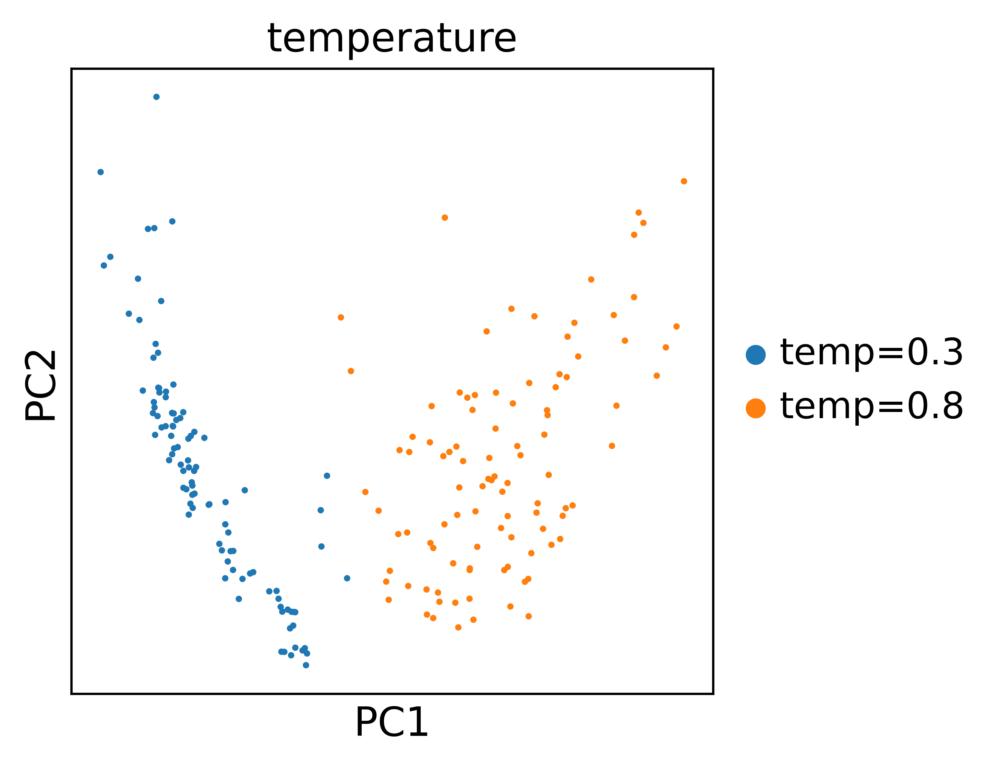

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


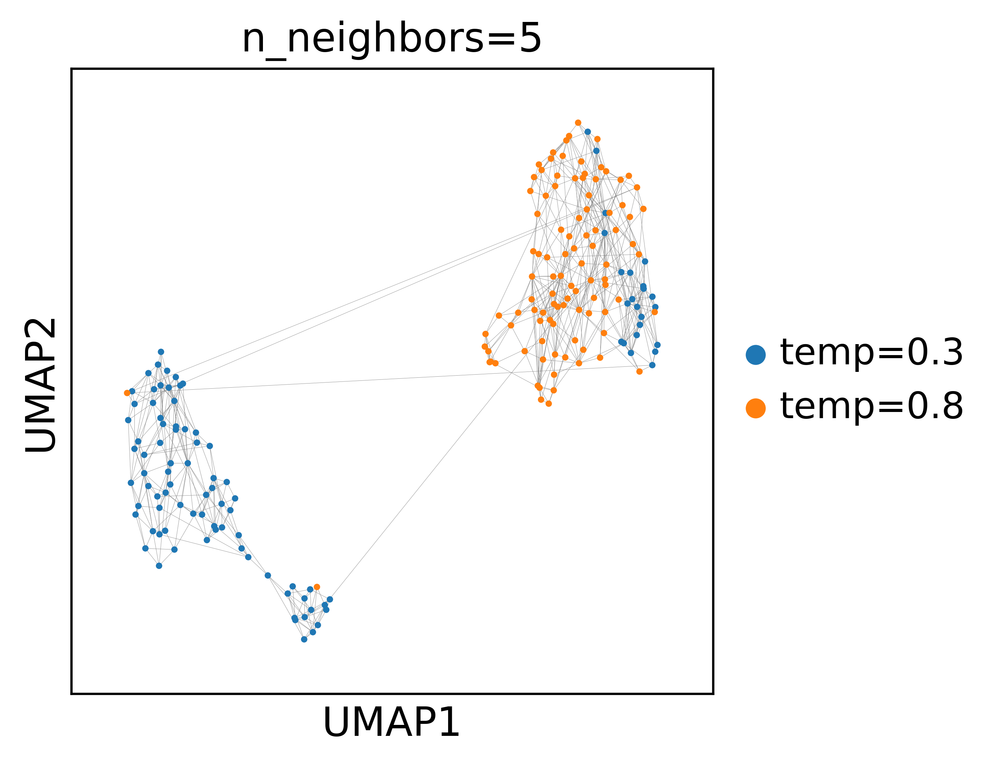

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


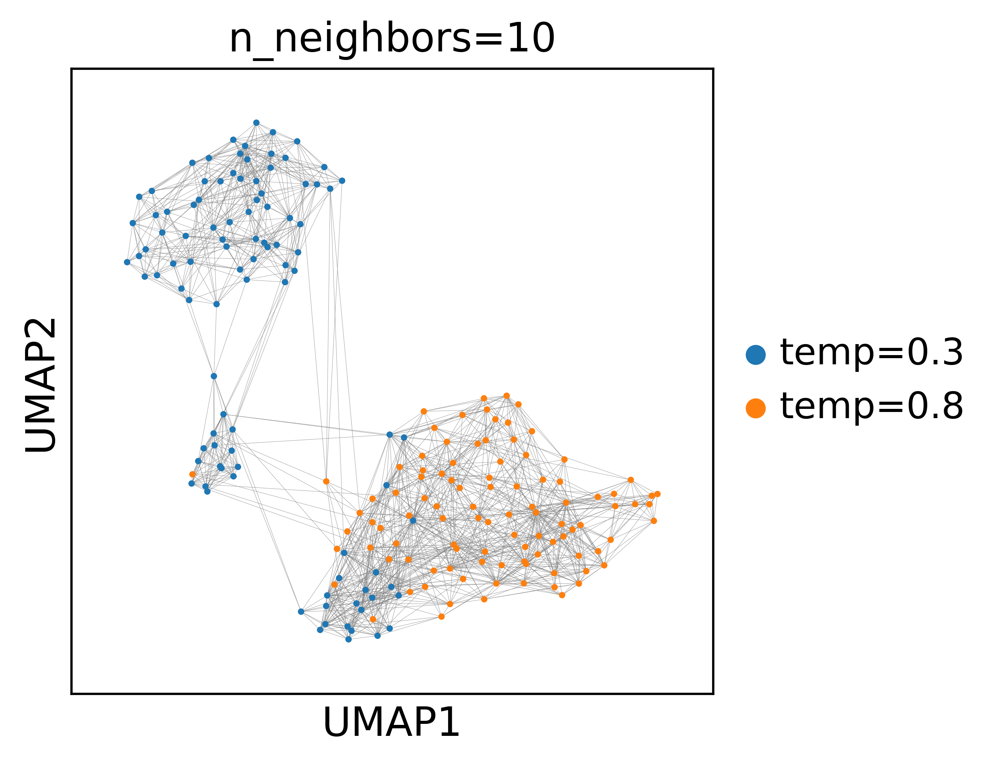

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


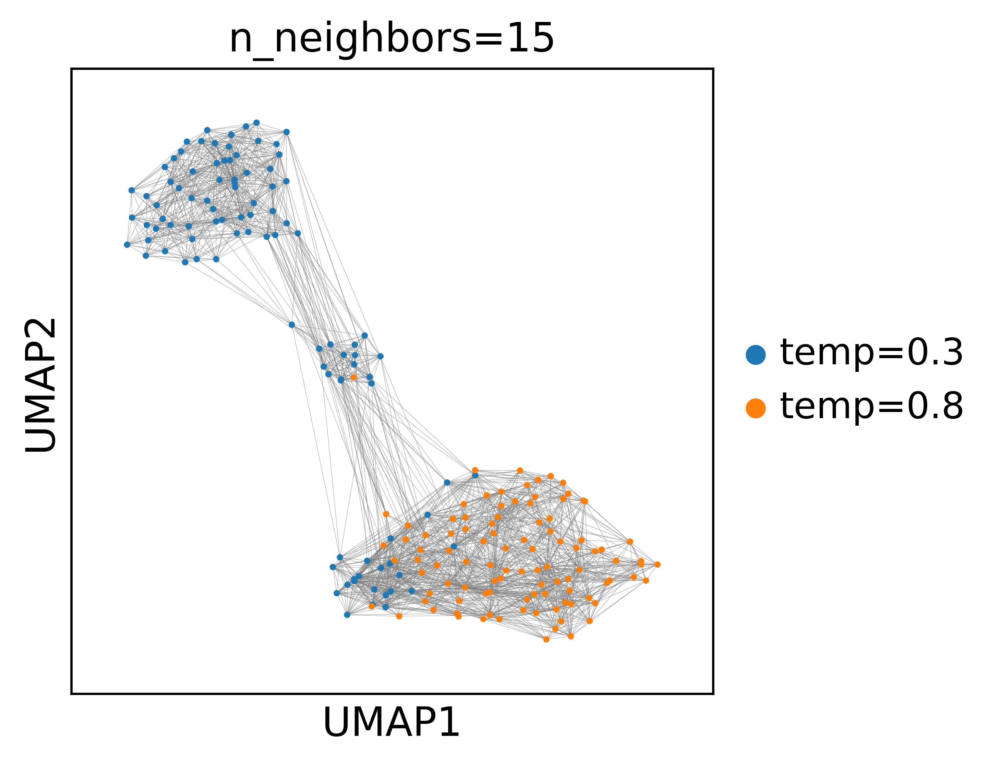

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


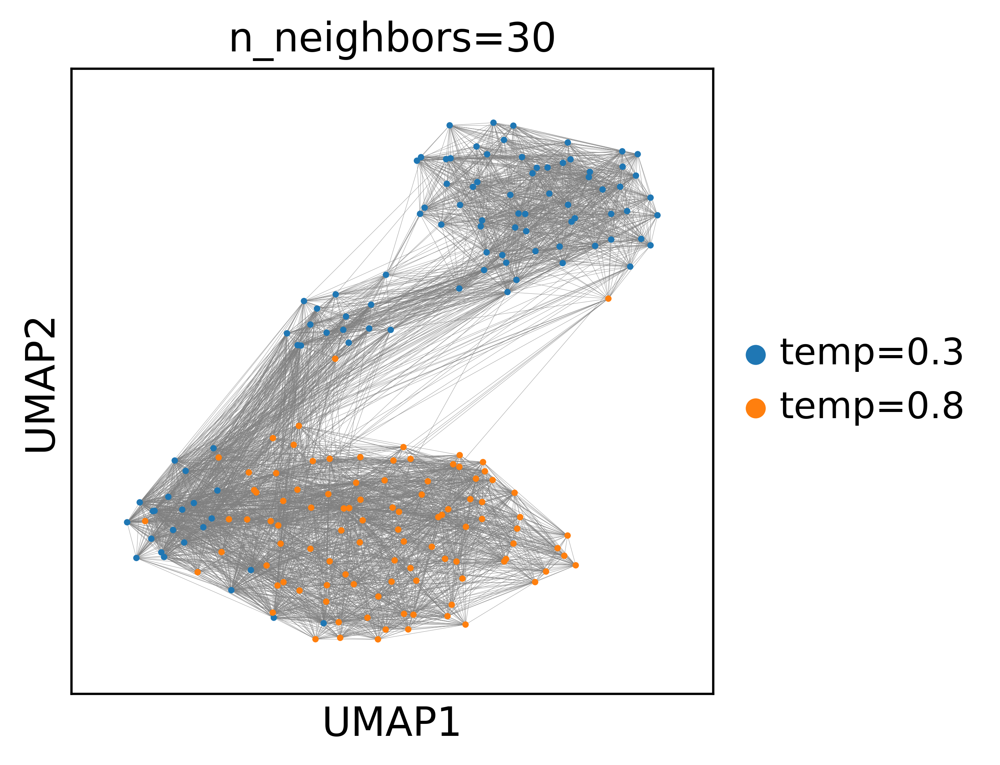

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


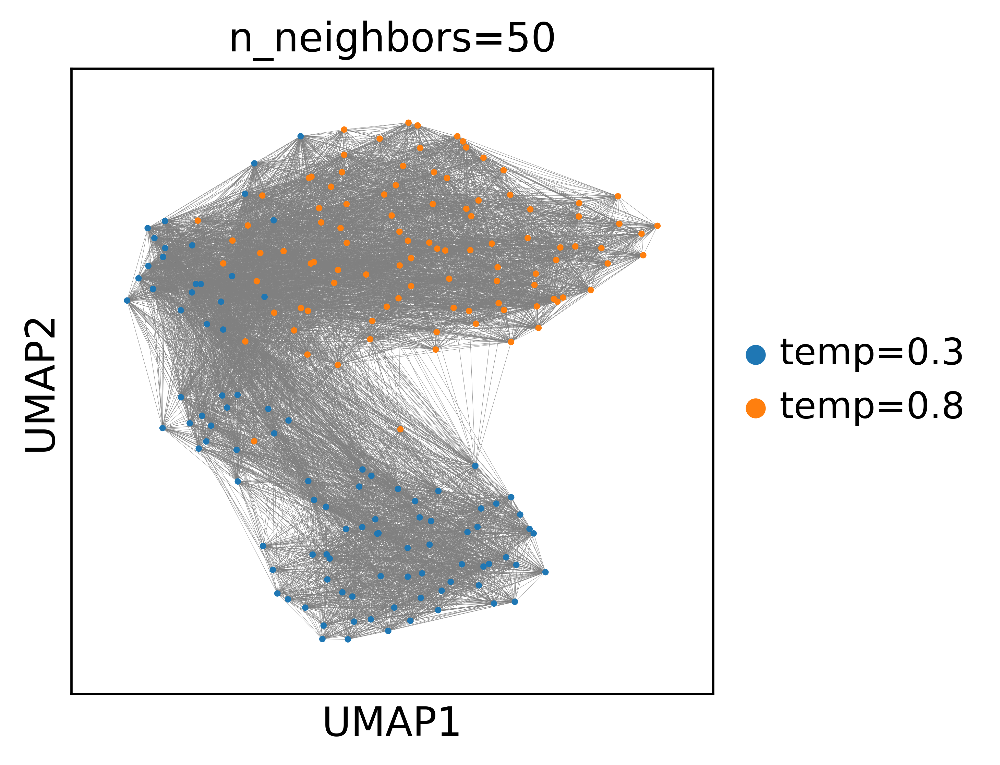

In [89]:
# Check the length of vocab_list and posteroir expression matrix
n_samples, n_genes = expr_samples_low.shape
print(n_samples, n_genes)
print(len(vocab_list))

# 1. obs with temperature labels
obs_low = pd.DataFrame(
    {"temperature": ["temp=0.3"] * n_samples},
    index=[f"low_{i}" for i in range(n_samples)],
)
obs_high = pd.DataFrame(
    {"temperature": ["temp=0.8"] * n_samples},
    index=[f"high_{i}" for i in range(n_samples)],
)
# display(obs_low)
# display(obs_high)

# 2. var copied from your reference adata (or built from vocab_list)
var = pd.DataFrame(index=pd.Index(vocab_list, name="gene"))

adata_low = ad.AnnData(
    X=expr_samples_low.astype(np.float32),
    obs=obs_low,
    var=var,
)
adata_high = ad.AnnData(
    X=expr_samples_high.astype(np.float32),
    obs=obs_high,
    var=var,
)
# print(adata_low)
# print(adata_high)

# 3. concatenate and run PCA/UMAP jointly
concat_adata = ad.concat([adata_low, adata_high], axis=0)
concat_adata.var = var  # ensure var is consistent
print(concat_adata)
print(concat_adata.X.max())
print(concat_adata.obs)

# 4. Visualize (same as in script1)
sc.pp.scale(concat_adata, zero_center=True, max_value=5) #ensure two datasets are transformed correctly before PCA
sc.tl.pca(concat_adata)
sc.pl.pca(
    concat_adata,
    color="temperature",
    size=20,
)

for k in [5, 10, 15, 30, 50]:
    sc.pp.neighbors(concat_adata, n_neighbors=k, n_pcs=50)
    sc.tl.umap(concat_adata)
    sc.pl.umap(concat_adata, color="temperature", size = 20, title=f"n_neighbors={k}", edges = True,)

# sc.pp.neighbors(concat_adata, n_neighbors=15, n_pcs=50)
# sc.tl.umap(concat_adata)

# Use top_k_genes=200 model

In [90]:
######## Load modules ########
from __future__ import annotations #default now for name.error issue
import os
## ensure model trains on one GPU
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
os.environ["WORLD_SIZE"] = "1"
import pickle
from datetime import datetime
import numpy as np
import random
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
SEED = 1234
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)
import scipy
from tqdm import tqdm

# Cell2Sentence imports
import cell2sentence as cs
# from cell2sentence.utils import benchmark_expression_conversion, reconstruct_expression_from_cell_sentence
from cell2sentence import utils
from cell2sentence.tasks import embed_cells, predict_cell_types_of_data
from cell2sentence.prompt_formatter import get_cell_sentence_str, PromptFormatter #for custom prompt

# Hugging Face
from transformers import TrainingArguments, AutoModelForCausalLM
from datasets import Dataset # Arrow

# Single-cell libraries
import scanpy as sc
import anndata as ad
from collections import Counter, defaultdict #count table

sc.set_figure_params(dpi=300, color_map="viridis_r", facecolor="white", )
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

# Define device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)


######## Re-load Perturbation Data ########
DATA_PATH = "/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq/GSE264667_jurkat_processed.h5ad"
adata = ad.read_h5ad(DATA_PATH)
print(adata)             # check dimension
print(adata.X.max())     # check max value (log10 transformation expects a maximum value somewhere around 3 or 4)
print(adata.var_names)   # will be used to create the __cell sentences__
# print(adata.var)

# target_gene_counter = Counter(adata.obs['target_gene'])
# print(f"{len(target_gene_counter)} unique perturbations")
# print(target_gene_counter.most_common(20)) #('non-targeting', 11742)!


#### recreate `vocab_list` used in `c2s_tvl_11v3_fullLength_perturbation_PosteriorEst.py` > `posterior_sentences_to_expression` ####
adata_obs_cols_to_keep = ['batch_var','cell_type','target_gene','gene_id','mitopercent','UMI_count']
arrow_ds, vocabulary = cs.CSData.adata_to_arrow(
    adata=adata, 
    random_state=SEED, 
    sentence_delimiter=' ',
    label_col_names=adata_obs_cols_to_keep
)
print(arrow_ds)
vocab_list = list(vocabulary.keys())

## check if the same
print(vocab_list[:10])
print(adata.var_names)


######## Load Posterior Estimations ######## 
# Load the sampling data
benchmarking_wd="/ix/ccdg/storage3/til177/ParkLab/Project_C2S_scFM/code/tutorials/data_PerturbSeq/perturbation_predictor_finetuned_final_benchmarking"
with open(os.path.join(benchmarking_wd, "posterior_samples_meta_script11v2.pkl"), "rb") as f:
    meta = pickle.load(f)

# Access results
print(meta["high_temp"].keys())
print(meta["low_temp"].keys())
print()

# same `n_samples`
print(meta["high_temp"]['n_samples'] == meta["low_temp"]['n_samples'])
print("'n_samples':", meta["high_temp"]['n_samples'])
print()
# same `prompt`
print(meta["low_temp"]['prompt'] == meta["high_temp"]['prompt'])
print("prompt:", meta["low_temp"]['prompt'][:1000])
print()

# `temperature`
print("'temperature':")
print(meta["high_temp"]['temperature'])
print(meta["low_temp"]['temperature'])
print()

#### Check cell sentences ####
# meta["high_temp"]['posterior_samples']
# meta["low_temp"]['posterior_samples']

#### Check expression matrix ####
expr_samples_high = meta["high_temp"]["expr_samples"]
expr_samples_low  = meta["low_temp"]["expr_samples"]

print(expr_samples_high.shape)
print(expr_samples_high)
print(expr_samples_high.max())

print(expr_samples_low.shape)

#### this is un-post-processed!!! Have duplicates ####
print(len(meta["high_temp"]['posterior_samples'][4].split(" ")) == len(set(meta["high_temp"]['posterior_samples'][4].split(" "))))

print(len(meta["high_temp"]['posterior_samples'][4].split(" ")))
print(len(set(meta["high_temp"]['posterior_samples'][4].split(" "))))


dict_keys(['temperature', 'posterior_samples', 'expr_samples', 'prompt', 'n_samples'])
dict_keys(['temperature', 'posterior_samples', 'expr_samples', 'prompt', 'n_samples'])

True
'n_samples': 100

True
prompt: Given the following cell sentence of 200 expressed genes representing a cell's basal state, predict the cell sentence after applying the perturbation: NELFE.
Control cell sentence: MT-CO3 MT-ATP6 MT-CO2 MT-ND4 MT-CO1 MT-CYB RPS2 GAPDH RPL13 RPS7 MT-ND1 EEF1A1 RPLP1 RPL7A RPL10 PTMA MT-ND3 RPS3 RPL6 RPS12 RPS3A MALAT1 RPL18A RPS6 ACTB RPS18 RPL37A RACK1 TMSB4X RPL8 RPS23 RPSA RPL18 RPS15 RPS27A RPL32 RPL11 MIF RPL5 RPL15 RPL19 RPL28 TUBA1B MT-ND2 RPL17 RPS14 HSP90AA1 RPL3 H3F3A RPS4X RPL23A RPL30 FTH1 RPL41 RPS13 RPS9 YBX1 RPS16 RPS5 NACA RPS27 RPLP0 FAU RPS19 TPT1 RPL39 RPL7 RPL21 RPL34 TRBC1 RPLP2 RPL26 RPS25 RPL9 RPL29 NME2 EEF1B2 RPS8 PPIA RPS29 RPL27 RPS20 RPS24 EEF1G RPS15A RPL23 RPL36 RPL12 HSP90AB1 RPL14 CALR HINT1 HMGB1 SERF2 RPL37 BTF3 RPL35 RPS28 RPS21 HSPD1 RPL24 RPL3

True
100 8882
8882
AnnData object with n_obs × n_vars = 200 × 8882
    obs: 'temperature'
2.4936645
        temperature
low_0      temp=0.3
low_1      temp=0.3
low_2      temp=0.3
low_3      temp=0.3
low_4      temp=0.3
...             ...
high_95    temp=0.8
high_96    temp=0.8
high_97    temp=0.8
high_98    temp=0.8
high_99    temp=0.8

[200 rows x 1 columns]
computing PCA
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


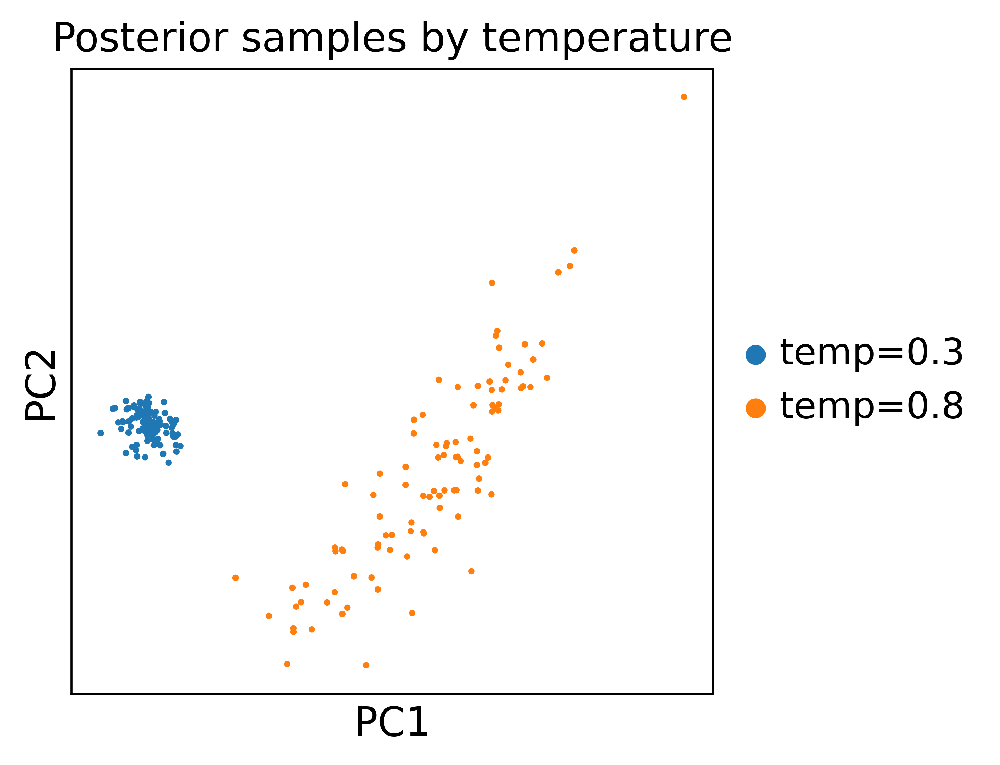

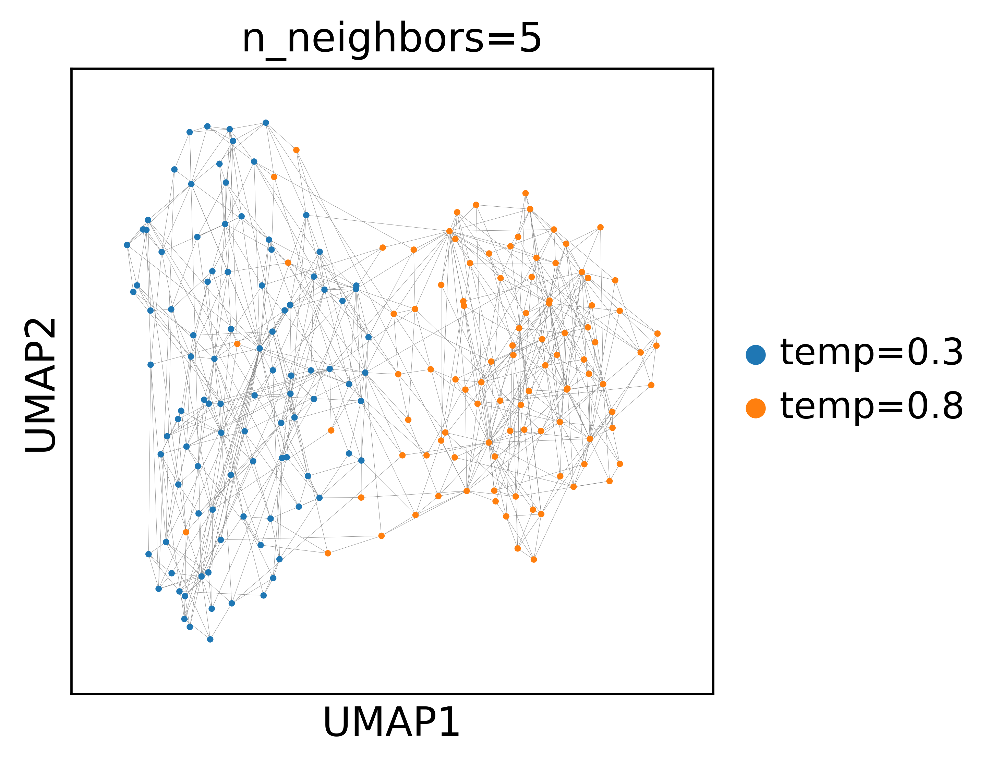

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


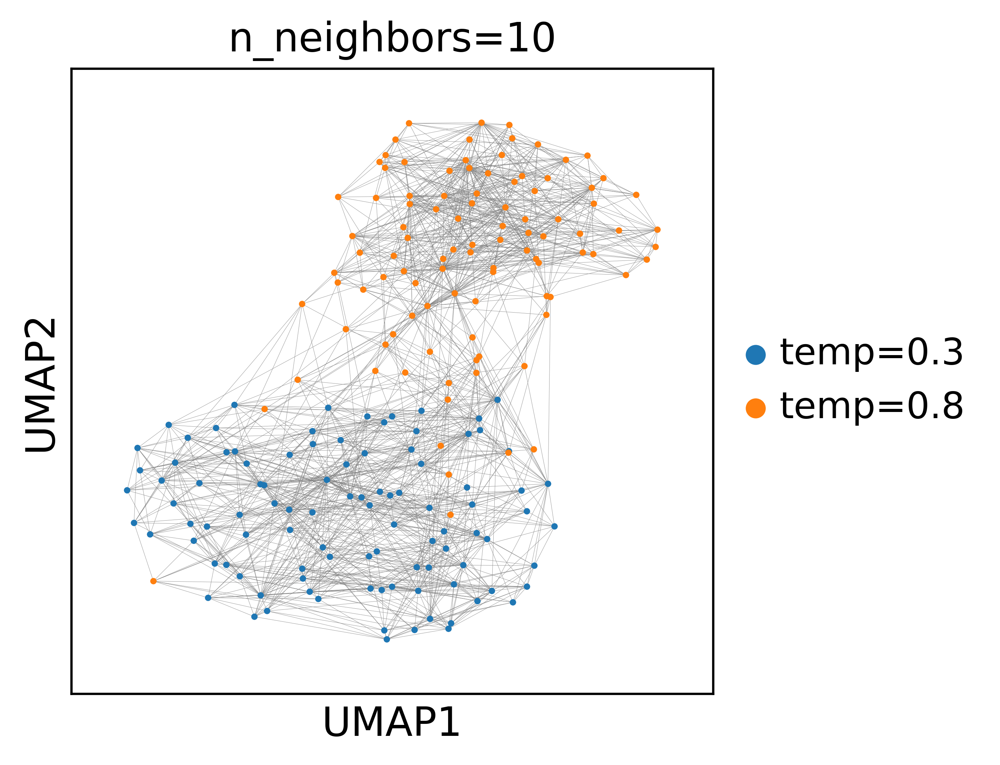

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


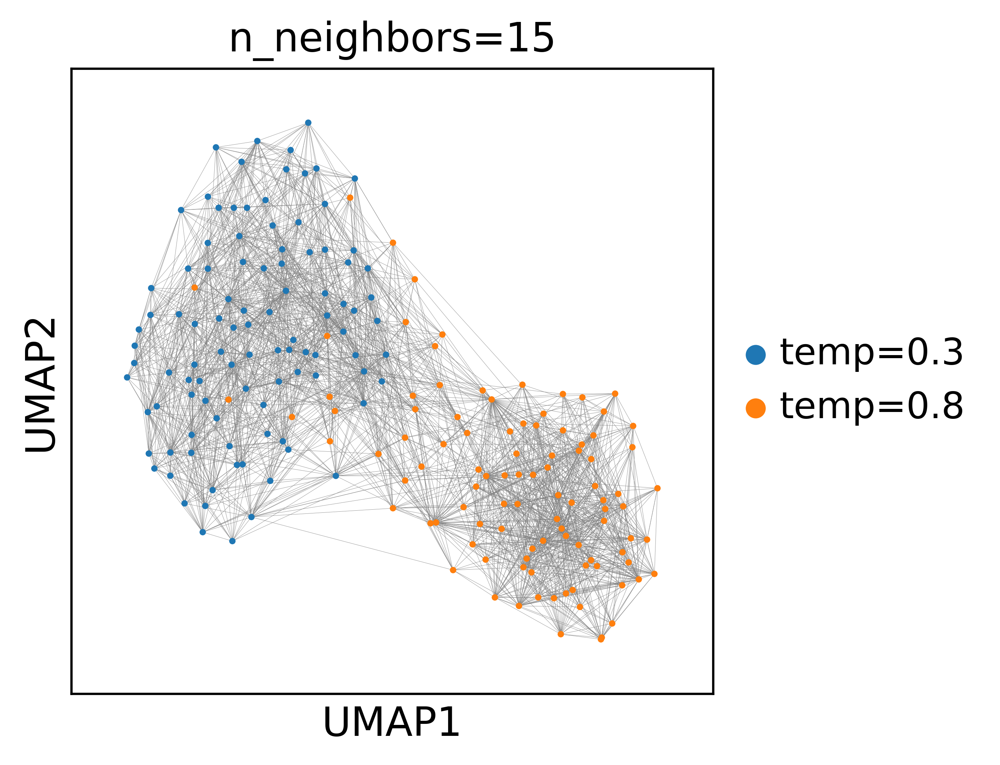

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


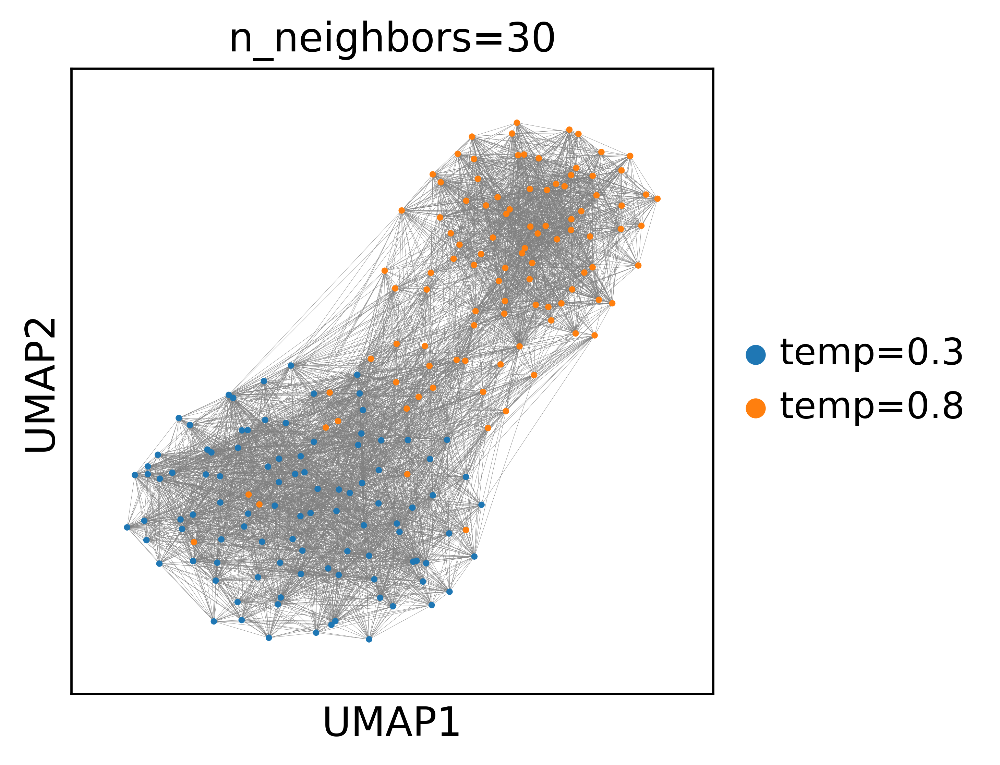

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


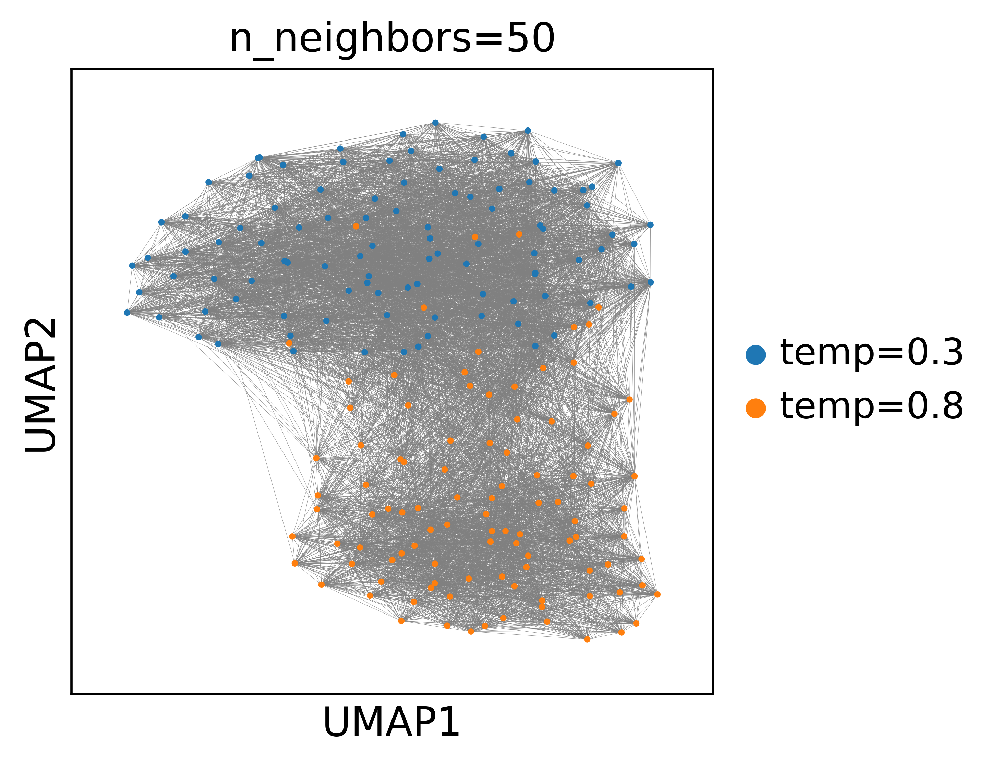

In [91]:
######## Create a merged anndata for visualization to _quality check_ if temperature difference during generation will create a different distribution of the samples (i.e., higher temperature would have a more spread distribution on the shared UMAP) ########

# top_k_genes=200

# Try 1: Use full reconstructed expression matrix
# Try 2 (later): Use union set of the two temperature samples
#     - Union mask keeps any gene that appears in either temperature at least once, so you preserve temperature-specific support changes while removing genes that are always zero in both groups.

print(expr_samples_low.shape == expr_samples_high.shape)
n_samples, n_genes = expr_samples_low.shape

# Check the length of vocab_list and posteroir expression matrix
print(n_samples, n_genes)
print(len(vocab_list))

# 1. obs with temperature labels
obs_low = pd.DataFrame(
    {"temperature": ["temp=0.3"] * n_samples},
    index=[f"low_{i}" for i in range(n_samples)],
)
obs_high = pd.DataFrame(
    {"temperature": ["temp=0.8"] * n_samples},
    index=[f"high_{i}" for i in range(n_samples)],
)
# display(obs_low)
# display(obs_high)

# 2. var copied from your reference adata (or built from vocab_list)
var = pd.DataFrame(index=pd.Index(vocab_list, name="gene"))

adata_low = ad.AnnData(
    X=expr_samples_low.astype(np.float32),
    obs=obs_low,
    var=var,
)
adata_high = ad.AnnData(
    X=expr_samples_high.astype(np.float32),
    obs=obs_high,
    var=var,
)
# print(adata_low)
# print(adata_high)

# 3. concatenate and run PCA/UMAP jointly
concat_adata = ad.concat([adata_low, adata_high], axis=0)
concat_adata.var = var  # ensure var is consistent
print(concat_adata)
print(concat_adata.X.max())
print(concat_adata.obs)

# 4. Visualize (same as in script1)
sc.pp.scale(concat_adata, zero_center=True, max_value=5) #ensure two datasets are transformed correctly before PCA
sc.tl.pca(concat_adata)
sc.pl.pca(
    concat_adata,
    color="temperature",
    size=20,
    title="Posterior samples by temperature",
    frameon=True, show=False,
)

for k in [5, 10, 15, 30, 50]:
    sc.pp.neighbors(concat_adata, n_neighbors=k, n_pcs=50)
    sc.tl.umap(concat_adata)
    sc.pl.umap(concat_adata, color="temperature", size = 20, title=f"n_neighbors={k}", edges = True, )

# sc.pp.neighbors(concat_adata, n_neighbors=15, n_pcs=50)
# sc.tl.umap(concat_adata)


In [103]:
def format_plot(ax, xlabel, ylabel,
                draw_axhline = True, draw_axvline = True,
                x_set_size_inches = 8,
                y_set_size_inches = 4,
                xticks_lb = -8, xticks_hb = 9, xticks_step = 2, #-8 to 8, step=2
                yticks_lb = -8, yticks_hb = 9, yticks_step = 2, #-8 to 8, step=2
               ):
    
    # Force ticks/labels to display
    ax.tick_params(axis="both", which="both", bottom=True, left=True, labelbottom=True, labelleft=True)
    ax.set_xticks(np.arange(xticks_lb, xticks_hb, xticks_step))
    ax.set_yticks(np.arange(yticks_lb, yticks_hb, yticks_step))
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    
    # Remove all gridlines (Scanpy/rcParams may enable them)
    ax.grid(False)
    # Draw ONLY the x=0 and y=0 lines
    if draw_axhline:
        ax.axhline(0, color="black", linewidth=0.3, alpha=0.6, zorder=3) #control the visual order
    if draw_axvline:
        ax.axvline(0, color="black", linewidth=0.3, alpha=0.6, zorder=3)
    
    plt.tight_layout()

    fig = ax.figure
    fig.set_size_inches(x_set_size_inches, y_set_size_inches)
    print(fig.get_size_inches())
    
    plt.show()

    return fig

/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


[8. 4.]


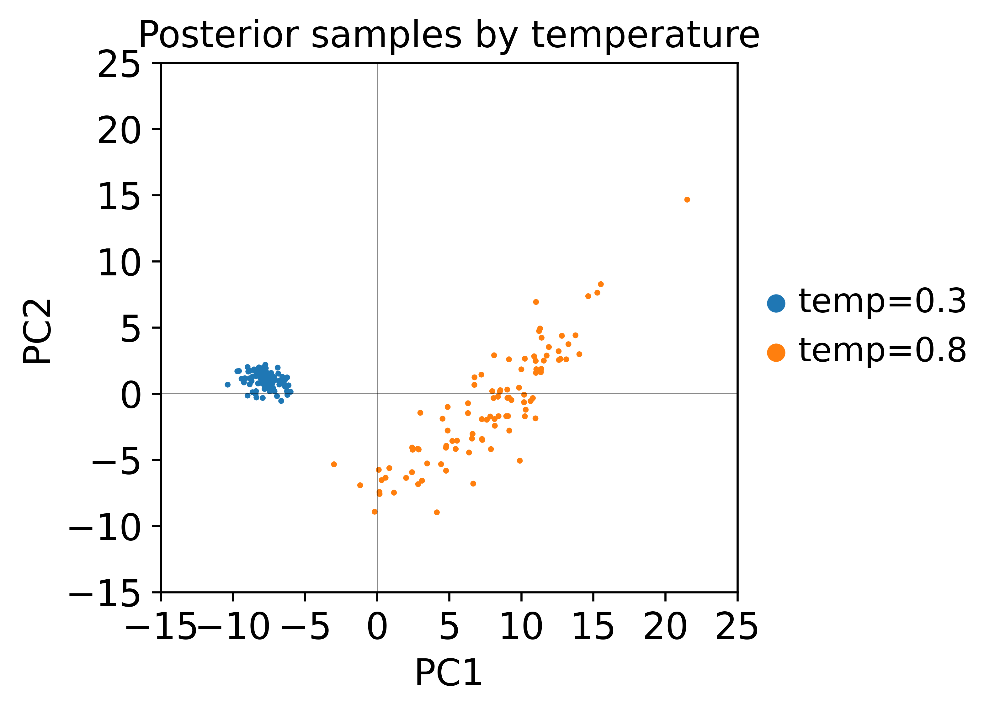

In [125]:
# PCA
ax = sc.pl.pca(
    concat_adata,
    color="temperature",
    size=20,
    title="Posterior samples by temperature",
    frameon=True, show=False,
)

fig = format_plot(ax, xlabel = "PC1", ylabel = "PC2",
                  xticks_lb = -15, xticks_hb = 26, xticks_step = 5,
                  yticks_lb = -15, yticks_hb = 26, yticks_step = 5)
# fig.savefig(
#     benchmarking_wd+"/PCA__top_k_genes200_PosteriorSamplesByTemp.png",
#     dpi=500,
#     bbox_inches="tight"
# )

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


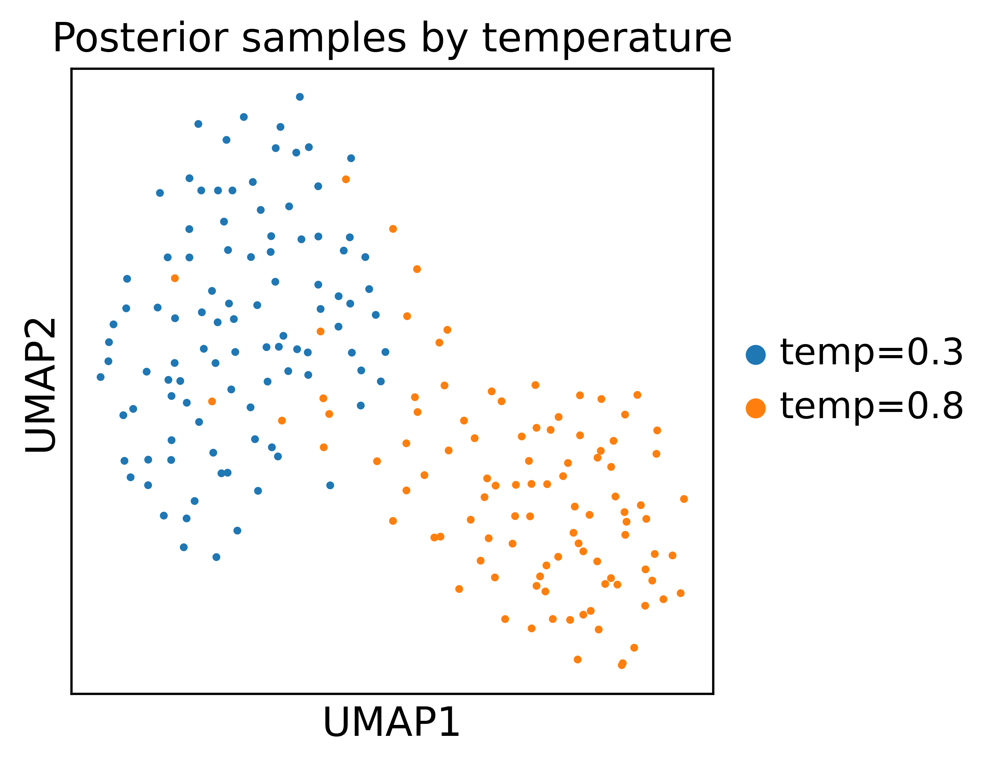

/ix/ccdg/storage3/til177/custom_miniconda/envs/cell2sentence/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


[8. 4.]


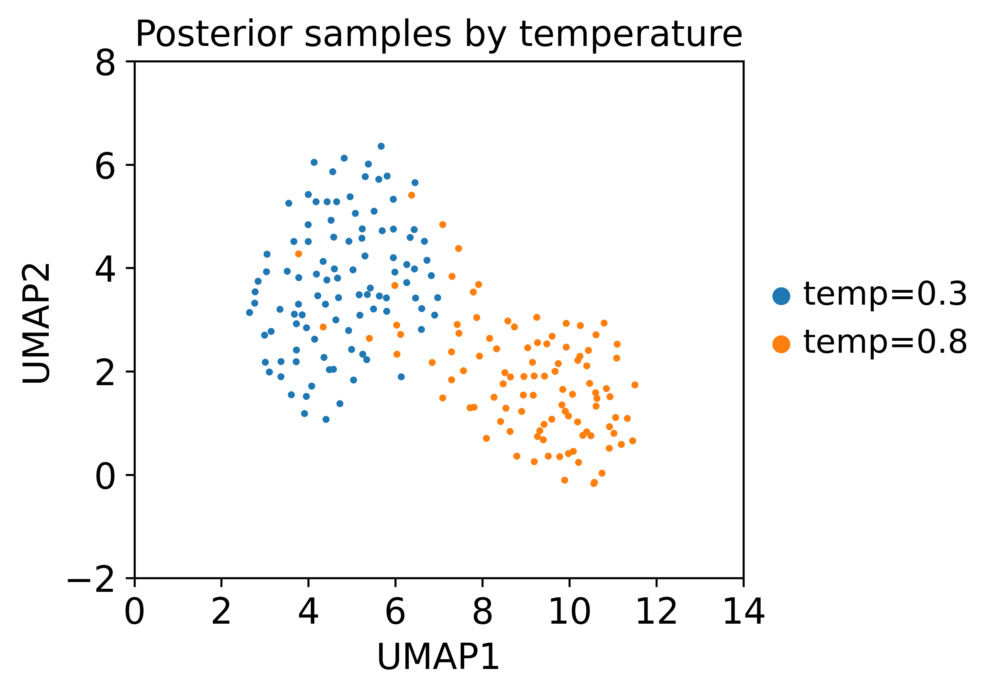

In [124]:
# UMAP
sc.pp.neighbors(concat_adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(concat_adata)
sc.pl.umap(
    concat_adata,
    color="temperature",
    size=30,
    title="Posterior samples by temperature",
    # edges = True,
    frameon=True, show=True,
)

# Save
ax = sc.pl.umap(
    concat_adata,
    color="temperature",
    size=30,
    title="Posterior samples by temperature",
    # edges = True,
    frameon=True, show=False,
)

fig = format_plot(ax, xlabel = "UMAP1", ylabel = "UMAP2",
                  draw_axvline = False, draw_axhline = False,
                  xticks_lb = 0, xticks_hb = 16, xticks_step = 2,
                  yticks_lb = -2, yticks_hb = 10, yticks_step = 2)
# fig.savefig(
#     benchmarking_wd+"/umap__top_k_genes200_PosteriorSamplesByTemp.png",
#     dpi=500,
#     bbox_inches="tight"
# )

<br>
<hr>

__Recap__

Study design: Perturb-seq using CRISPR (KO) 

- __The inference_prompt we get -> one specific perturbation (here, KO '_NELFE_') in one specific cell state.__

- Can test the rank calculation in ver0.docx

    - $g_{i..N}$: top $N$=200 genes
    - B = 100
    - Output: (B,N) rank matrix

In [ ]:
def get_postprocessingSentences()

def get_geneList()

def build_rank_matrix_from_sentences(posterior_sentences, gene_list, unknown_rank=None):
    """
    Build a (B, N) rank matrix from posterior C2S sentences.

    Args:
        posterior_sentences (list[str]): length B; each is a C2S cell sentence string
                                         for the SAME perturbation prompt.
                                         Assumed format: space-separated gene tokens,
                                         possibly ending with a period.
        gene_list (list[str]): length N; global list of genes G = {g1,...,gN}.
                               This fixes the column order of the rank matrix.
        unknown_rank (int or None): rank to assign if a gene is not present in a sentence.
                                    If None, use len(tokens) + 1 for that sample.

    Returns:
        np.ndarray: rank_matrix with shape (B, N),
                    rank_matrix[b, i] = rank of gene_list[i] in sample b (1 = most important).
    """
#     B = len(posterior_sentences)
#     N = len(gene_list)
#     rank_matrix = np.zeros((B, N), dtype=np.int32)

#     # Map gene -> column index once
#     gene_to_col = {g: i for i, g in enumerate(gene_list)}

#     for b, sent in enumerate(posterior_sentences):
#         # Clean and split sentence into tokens
#         sent = sent.rstrip(".")
#         tokens = sent.split(" ")

#         # Map token -> rank (1-based: first token rank 1, second rank 2, ...)
#         token_to_rank = {tok: (idx + 1) for idx, tok in enumerate(tokens)}

#         # Default rank for missing genes
#         default_rank = unknown_rank if unknown_rank is not None else (len(tokens) + 1)

#         # Fill row b of rank_matrix
#         for i, g in enumerate(gene_list):
#             rank_matrix[b, i] = token_to_rank.get(g, default_rank)

#     return rank_matrix

# # ===== Example usage =====

# # posterior_sentences: list[str], length = B
# # gene_list: list[str], length = N (e.g. adata.var_names.tolist() or your C2S vocab order)

# rank_matrix = build_rank_matrix_from_sentences(
#     posterior_sentences=posterior_sentences,
#     gene_list=gene_list,          # your global gene ordering
#     unknown_rank=None,            # missing genes get rank = len(tokens)+1
# )

# print("rank_matrix shape (B, N):", rank_matrix.shape)

# # Now compute per-gene posterior mean rank and sd:
# mean_rank = rank_matrix.mean(axis=0)
# std_rank  = rank_matrix.std(axis=0, ddof=1)

# print("mean_rank shape (N,):", mean_rank.shape)
# print("std_rank  shape (N,):", std_rank.shape)

In [ ]:
# sentence = posterior_sentences[3]
# sentence_gene_list = sentence.split(" ")
# # print(sentence_gene_list)
# # Counter(sentence_gene_list)
# # [x for x, c in Counter(sentence_gene_list).items() if c > 1]
# print(len(sentence_gene_list))

# sentence_gene_list_set = set(sentence_gene_list)
# print(len(sentence_gene_list_set))

197
196
